## Подготовительная работа
* [Installing a Library Permanently in Colab](https://saturncloud.io/blog/how-to-install-a-library-permanently-in-colab/)

In [1]:
## connect google drive
from google.colab import drive


drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [2]:
!pip install virtualenv
!virtualenv /content/drive/MyDrive/vkr/kmu/virtual_env

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.9/3.9 MB 4.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 468.9/468.9 kB 4.0 MB/s eta 0:00:00
created virtual environment CPython3.10.12.final.0-64 in 30995ms
  creator CPython3Posix(dest=/content/drive/MyDrive/vkr/kmu/virtual_env, clear=False, no_vcs_ignore=False, global=False)
  seeder FromAppData(download=False, pip=bundle, setuptools=bundle, wheel=bundle, via=copy, app_data_dir=/root/.local/share/virtualenv)
    added seed packages: Babel==2.14.0, Cython==0.29.37, DAWG_Python==0.7.2, Deprecated==1.2.14, Janome==0.5.0, Jinja2==3.1.3, MarkupSafe==2.1.5, PySocks==1.7.1, PyYAML==6.0.1, Wikipedia_API==0.6.0, affine==2.4.0, aiohttp==3.9.3, aiosignal==1.3.1, alabaster==0.7.16, async_timeout==4.0.3, attrs==23.2.0, autodocsumm==0.2.12, beautifulsoup4==4.12.3, blosc2==2.6.1, boto3==1.34.80, botocore==1.34.80, bpemb==0.3.5, certifi==2024.2.2, charset_normalizer==3.3.2, click==8.1.7, click_plugins==1.1.1, cligj==0.7.2, cloudpick

In [3]:
import sys


venv_path = "/content/drive/MyDrive/vkr/kmu/virtual_env/lib/python3.10/site-packages"
if venv_path not in sys.path:
  # add the path of the virtual environment site-packages to colab system path
  sys.path.append(venv_path)
sys.path

['/content',
 '/env/python',
 '/usr/lib/python310.zip',
 '/usr/lib/python3.10',
 '/usr/lib/python3.10/lib-dynload',
 '',
 '/usr/local/lib/python3.10/dist-packages',
 '/usr/lib/python3/dist-packages',
 '/usr/local/lib/python3.10/dist-packages/IPython/extensions',
 '/root/.ipython',
 '/content/drive/MyDrive/vkr/kmu/virtual_env/lib/python3.10/site-packages']

## H3

```bash
!source /content/drive/MyDrive/vkr/kmu/virtual_env/bin/activate; pip install pyrosm contextily mapclassify osmnx pandana h3pandas
```

In [ ]:
!source /content/drive/MyDrive/vkr/kmu/virtual_env/bin/activate; pip install bertopic

In [ ]:
!source /content/drive/MyDrive/vkr/kmu/virtual_env/bin/activate; pip install h3pandas

In [ ]:
!source /content/drive/MyDrive/vkr/kmu/virtual_env/bin/activate; pip install -r /content/drive/MyDrive/vkr/kmu/SOIKA/requirements.txt

ERROR: Operation cancelled by user


In [ ]:
#pytest -s test/

In [ ]:
!source /content/drive/MyDrive/vkr/kmu/virtual_env/bin/activate; git clone https://github.com/iduprojects/SOIKA.git; cd SOIKA; pip install -r requirements.txt; pytest -s test/

In [ ]:
!pip freeze

### Конфигурация

In [4]:
DIR_OSM = '/content/drive/MyDrive/vkr/kmu/src/osm/'
CITY = 'SanktPetersburg'
#BBOX = [30.2561753, 59.929385, 30.3637657, 59.9832816]
BBOX = [30.2665719, 59.8913232, 30.4101337, 59.9632426]

UTM_ZONE = 32636
MAP_DIST = 50
MAX_DIST = 500
MAX_ITEMS = 10

config = {
    'dir_osm': DIR_OSM,
    'city': CITY,
    'crs': UTM_ZONE,
    'filters': {
        'buildings': {
            'all': {
                'building': True
            },
            'residential_only': {
                'building': [
                'apartments',
                'residential'
              ]
            }
        },
        'POIs': {
            'shop': [
                'convenience',
                'supermarket',
                'mall',
                'greengrocer'
            ],
            'amenity': [
                'pharmacy',
                'university',
                'school',
                'kindergarten',
                'clinic',
                'car_wash'
            ],
            'healthcare': [
                'clinic'
            ]
        },
        'network_type': [
            'walking',
            'driving'
        ]
    },
    'bbox': BBOX,
    'map_dist': MAP_DIST,
    'max_dist': MAX_DIST,
    'max_items': MAX_ITEMS
}

### Логирование

<details>
<summary> Log levels</summary>

```py
logging.debug("A DEBUG Message")
logging.info("An INFO")
logging.warning("A WARNING")
logging.error("An ERROR")
logging.critical("A message of CRITICAL severity")
```
</details>

In [ ]:
!pwd

/content


In [5]:
import logging
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

logger = logging.getLogger()
fhandler = logging.FileHandler(filename=config["dir_osm"]+'h3_'+start+'.log', mode='w')
logger.addHandler(fhandler)
logger.setLevel(logging.INFO)

### Загрузка подготовленных данных

In [7]:
from geopandas import read_file


fp = ''
network_type = config['filters']['network_type'][0]
#network_type = config['filters']['network_type'][1]

if 'bbox' in config:
  fp = DIR_OSM + 'spb_bbox_' + start + '.gpkg'

  # buildings
  buildings = read_file(fp, layer='buildings_with_objective_metrics')
  if buildings.crs is None:
     logger.info(f'buildings crs is None')

  # pois
  pois = read_file(fp, layer='pois').set_index('id')
  if pois.crs is None:
     logger.info(f'pois crs is None')

  # graph
  nodes = read_file(fp, layer=f'{network_type}_nodes').set_index('id')
  edges = read_file(fp, layer=f'{network_type}_edges')
  if nodes.crs is None:
     logger.info(f'graph crs is None')

  logger.info(f'read buildings/pois/{network_type}_graph from {fp}')

else:
  fp = DIR_OSM + 'spb_'+ start +'.gpkg'

  # buildings
  buildings = read_file(fp, layer='buildings_with_objective_metrics')
  if buildings.crs is None:
     logger.info(f'buildings crs is None')

  # pois
  pois = read_file(fp, layer='pois').set_index('id')
  if pois.crs is None:
     logger.info(f'pois crs is None')

  # graph
  nodes = read_file(fp, layer=f'{network_type}_nodes').set_index('id')
  edges = read_file(fp, layer=f'{network_type}_edges')
  if nodes.crs is None:
     logger.info(f'graph crs is None')

  logger.info(f'read buildings/pois/{network_type}_graph from {fp}')


INFO:root:read buildings/pois/walking_graph from /content/drive/MyDrive/vkr/kmu/src/osm/spb_bbox_2024_05_06.gpkg


In [8]:
buildings.head(2)

,id,building,levels,country,city,street,housenumber,osm_type,centroid_x,centroid_y,node_id,access_sum,k_div_access,accessibility,proximity,obj,geometry
0,22967564,apartments,5,RU,Санкт-Петербург,Кронверкский проспект,63/31,way,349568.604639,6.649377e+06,1.058809e+10,1.451756,0.8,1.161405,2.593460,3.754865,"POLYGON ((349578.732 6649376.838, 349577.244 6..."
1,23088593,apartments,5,RU,Санкт-Петербург,улица Стахановцев,9,way,355125.226808,6.646045e+06,2.162657e+07,0.450850,0.8,0.360680,2.103516,2.464196,"POLYGON ((355124.500 6646068.154, 355127.464 6..."


In [9]:
pois.head(2)

,pois,pois_cat,name,osm_type,centroid_x,centroid_y,geometry
id,,,,,,,
311101154,pharmacy,pharmacy,У театра,node,348417.017363,6.646147e+06,POINT (348417.017 6646147.340)
311101166,kindergarten,education,Детский сад № 60,node,348459.251380,6.646128e+06,POINT (348459.251 6646128.172)


In [10]:
nodes.head(2)

,x,y,geometry
id,,,
10240355599,350768.977867,6.647817e+06,POINT (350768.978 6647816.641)
1591433310,350772.206656,6.647831e+06,POINT (350772.207 6647830.545)


In [11]:
edges.head(2)

,u,v,length,oneway,highway,geometry
0,10240355599,1591433310,14.247,no,unclassified,"LINESTRING (350768.978 6647816.641, 350769.630..."
1,1591433310,9296451194,24.230,no,unclassified,"LINESTRING (350772.207 6647830.545, 350777.960..."


### Гексагоны с Obj

In [13]:
buildings['centroid'] = buildings.centroid

In [14]:
buildings.head(2)

,id,building,levels,country,city,street,housenumber,osm_type,centroid_x,centroid_y,node_id,access_sum,k_div_access,accessibility,proximity,obj,geometry,centroid
0,22967564,apartments,5,RU,Санкт-Петербург,Кронверкский проспект,63/31,way,349568.604639,6.649377e+06,1.058809e+10,1.451756,0.8,1.161405,2.593460,3.754865,"POLYGON ((349578.732 6649376.838, 349577.244 6...",POINT (349568.605 6649377.134)
1,23088593,apartments,5,RU,Санкт-Петербург,улица Стахановцев,9,way,355125.226808,6.646045e+06,2.162657e+07,0.450850,0.8,0.360680,2.103516,2.464196,"POLYGON ((355124.500 6646068.154, 355127.464 6...",POINT (355125.227 6646045.149)


In [19]:
WGS84 = 4326
buildings_3d = buildings.drop(columns=['centroid_x', 'centroid_y', 'geometry']).rename(columns={'centroid': 'geometry'}).to_crs(crs=WGS84)
logger.info(f'reproject buldings to {WGS84}')

INFO:root:reproject buldings to 4326


In [20]:
buildings_3d.head(2)

,id,building,levels,country,city,street,housenumber,osm_type,node_id,access_sum,k_div_access,accessibility,proximity,obj,geometry
0,22967564,apartments,5,RU,Санкт-Петербург,Кронверкский проспект,63/31,way,1.058809e+10,1.451756,0.8,1.161405,2.593460,3.754865,POINT (30.30624 59.95424)
1,23088593,apartments,5,RU,Санкт-Петербург,улица Стахановцев,9,way,2.162657e+07,0.450850,0.8,0.360680,2.103516,2.464196,POINT (30.40796 59.92635)


In [29]:
buildings_3d.shape

(3044, 15)

#### h3_08

In [61]:
import h3pandas

res = 8
res_tag = 'h3_08'
buildings_3d_test = buildings_3d[['obj', 'geometry']]
hex_08_with_obj = buildings_3d_test.h3.geo_to_h3_aggregate(res, operation='mean').reset_index()
logger.info(f'aggregate obj indecator to {res_tag}')

INFO:root:aggregate obj indecator to h3_08


In [62]:
hex_08_with_obj.head(2)

,h3_08,obj,geometry
0,8811060441fffff,1.286122,"POLYGON ((30.39850 59.91740, 30.40383 59.91400..."
1,8811060445fffff,1.172522,"POLYGON ((30.40103 59.90957, 30.40636 59.90617..."


In [63]:
hex_08_with_obj.h3_08.value_counts()

h3_08
8811060441fffff    1
8811061495fffff    1
88110614b3fffff    1
88110614b1fffff    1
88110614adfffff    1
                  ..
881106063bfffff    1
8811060639fffff    1
8811060637fffff    1
8811060635fffff    1
881106a96dfffff    1
Name: count, Length: 101, dtype: int64

In [64]:
hex_08_with_obj_proj = hex_08_with_obj.to_crs(config['crs'])

In [65]:
hex_08_with_obj_proj.head(2)

,h3_08,obj,geometry
0,8811060441fffff,1.286122,"POLYGON ((354557.941 6645070.626, 354840.976 6..."
1,8811060445fffff,1.172522,"POLYGON ((354664.741 6644193.397, 354947.789 6..."


INFO:root:save h3_08 cells with obj to /content/drive/MyDrive/vkr/kmu/src/osm/images/h3_08_cells_with_obj_via_walking_network_2024_05_06.png


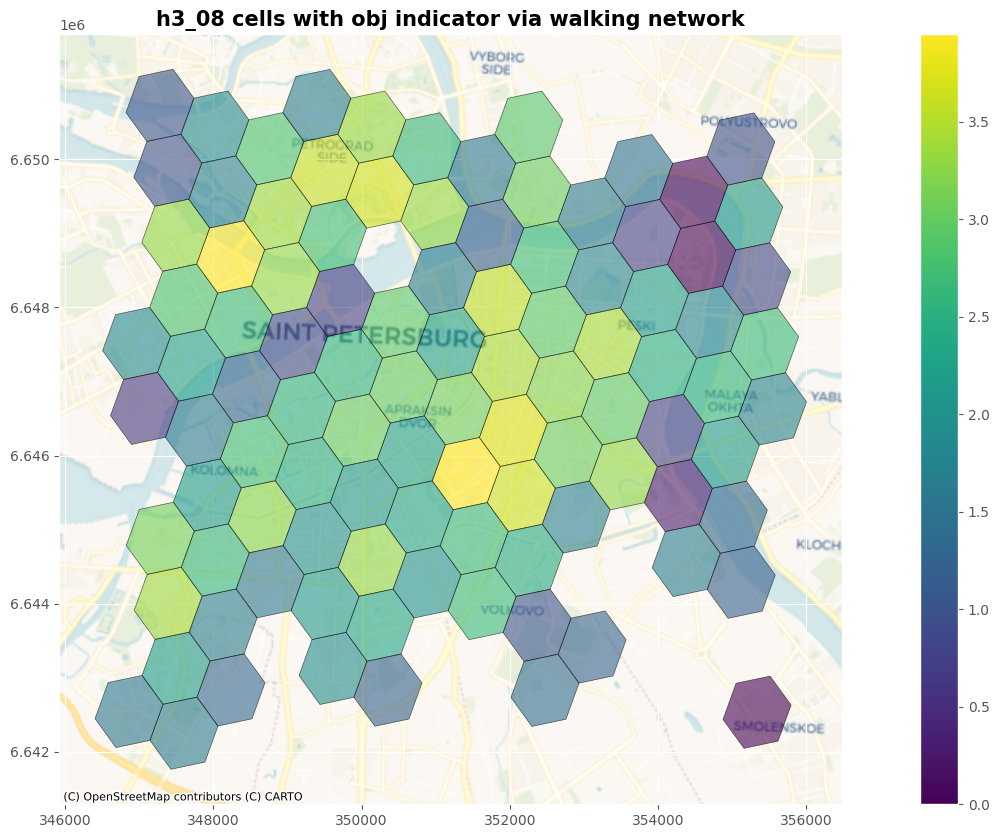

In [66]:
import contextily as cx
from matplotlib import pyplot as plt
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

with plt.style.context("ggplot"):
  ax = hex_08_with_obj_proj.plot(figsize=(20, 10), column='obj', legend=True, edgecolor='black', alpha=0.6)
  cx.add_basemap(ax=ax, crs=hex_08_with_obj_proj.crs.to_string(), source=cx.providers.CartoDB.Voyager)
  ax.set_title(f'{res_tag} cells with obj indicator via {network_type} network', fontsize=15, fontweight='bold')
  fp = config['dir_osm']+f'images/{res_tag}_cells_with_obj_via_{network_type}_network_'+start+'.png'
  plt.savefig(fp, bbox_inches='tight')
  logger.info(f'save {res_tag} cells with obj to {fp}')
  plt.show()

INFO:root:save h3_08 cells with obj to /content/drive/MyDrive/vkr/kmu/src/osm/images/h3_08_cells_with_obj_via_walking_network_with_pois_2024_05_06.png


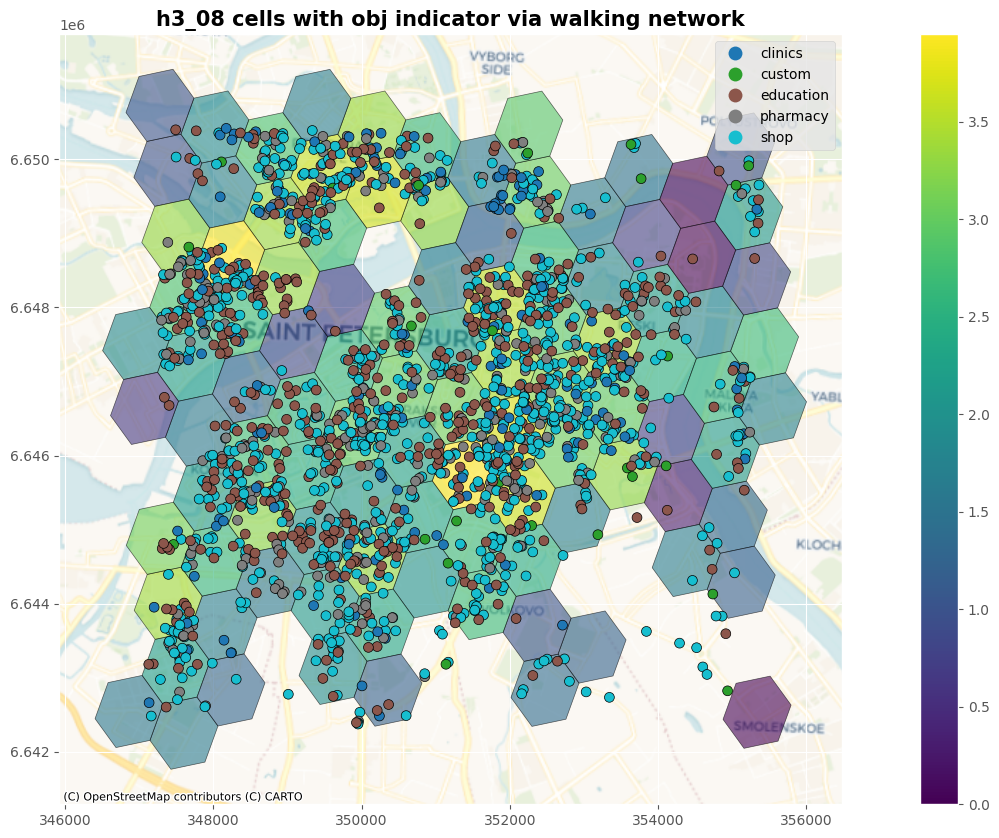

In [70]:
import contextily as cx
from matplotlib import pyplot as plt
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

with plt.style.context("ggplot"):
  ax = hex_08_with_obj_proj.plot(figsize=(20, 10), column='obj', legend=True, edgecolor='black', alpha=0.6)
  ax = pois.plot(ax=ax, column='pois_cat', legend=True, markersize=50, edgecolor='black')
  cx.add_basemap(ax=ax, crs=hex_08_with_obj_proj.crs.to_string(), source=cx.providers.CartoDB.Voyager)
  ax.set_title(f'{res_tag} cells with obj indicator via {network_type} network', fontsize=15, fontweight='bold')
  fp = config['dir_osm']+f'images/{res_tag}_cells_with_obj_via_{network_type}_network_with_pois_'+start+'.png'
  plt.savefig(fp, bbox_inches='tight')
  logger.info(f'save {res_tag} cells with obj to {fp}')
  plt.show()

INFO:root:save h3_08 cells with obj to /content/drive/MyDrive/vkr/kmu/src/osm/images/h3_08_cells_with_obj_via_walking_network_with_pois_zoom_2024_05_06.png


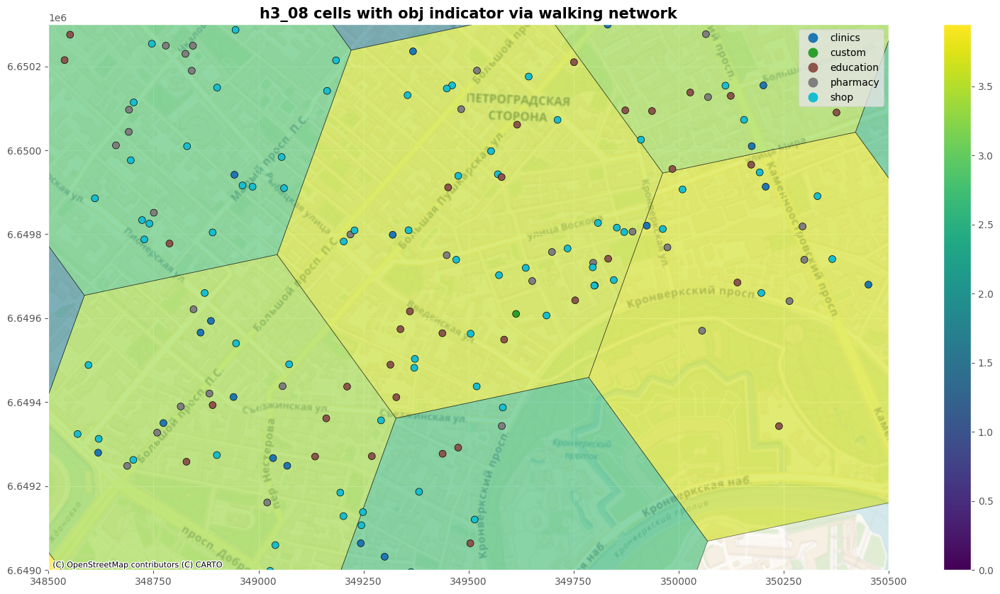

In [71]:
import contextily as cx
from matplotlib import pyplot as plt
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

with plt.style.context("ggplot"):
  ax = hex_08_with_obj_proj.plot(figsize=(20, 10), column='obj', legend=True, edgecolor='black', alpha=0.6)
  ax = pois.plot(ax=ax, column='pois_cat', legend=True, markersize=50, edgecolor='black')
  plt.setp(ax, xlim=(348500, 350500), ylim=(6649000, 6650300))
  cx.add_basemap(ax=ax, crs=hex_08_with_obj_proj.crs.to_string(), source=cx.providers.CartoDB.Voyager)
  ax.set_title(f'{res_tag} cells with obj indicator via {network_type} network', fontsize=15, fontweight='bold')
  fp = config['dir_osm']+f'images/{res_tag}_cells_with_obj_via_{network_type}_network_with_pois_zoom_'+start+'.png'
  plt.savefig(fp, bbox_inches='tight')
  logger.info(f'save {res_tag} cells with obj to {fp}')
  plt.show()

INFO:root:save h3_08 cells with obj to /content/drive/MyDrive/vkr/kmu/src/osm/images/h3_08_cells_with_obj_via_walking_network_with_pois_zoom_extra_2024_05_06.png


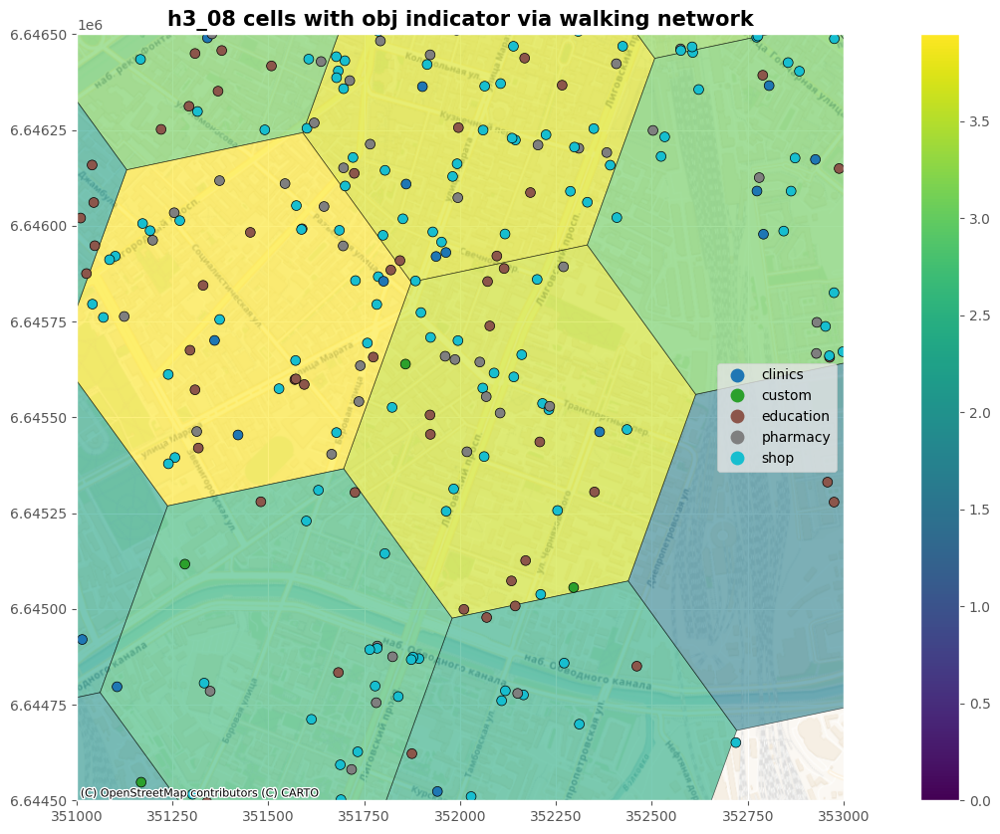

In [72]:
import contextily as cx
from matplotlib import pyplot as plt
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

with plt.style.context("ggplot"):
  ax = hex_08_with_obj_proj.plot(figsize=(20, 10), column='obj', legend=True, edgecolor='black', alpha=0.6)
  ax = pois.plot(ax=ax, column='pois_cat', legend=True, markersize=50, edgecolor='black')
  plt.setp(ax, xlim=(351000, 353000), ylim=(6644500, 6646500))
  cx.add_basemap(ax=ax, crs=hex_08_with_obj_proj.crs.to_string(), source=cx.providers.CartoDB.Voyager)
  ax.set_title(f'{res_tag} cells with obj indicator via {network_type} network', fontsize=15, fontweight='bold')
  fp = config['dir_osm']+f'images/{res_tag}_cells_with_obj_via_{network_type}_network_with_pois_zoom_extra_'+start+'.png'
  plt.savefig(fp, bbox_inches='tight')
  logger.info(f'save {res_tag} cells with obj to {fp}')
  plt.show()

/usr/local/lib/python3.10/dist-packages/geopandas/plotting.py:658: UserWarning: Only specify one of 'column' or 'color'. Using 'color'.
  warnings.warn(
INFO:root:save h3_09 cells with obj to /content/drive/MyDrive/vkr/kmu/src/osm/images/h3_09_cells_with_obj_via_walking_network_with_pois_and_buildings_zoom_extra_2024_05_06.png


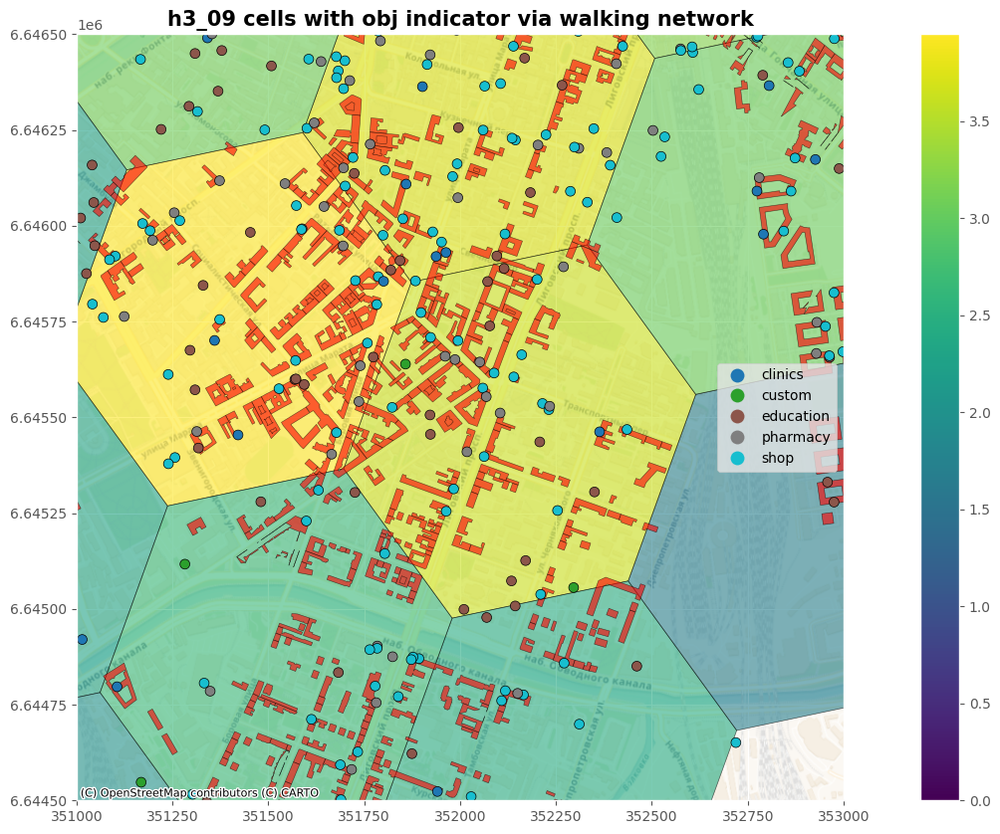

In [86]:
import contextily as cx
from matplotlib import pyplot as plt
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

with plt.style.context("ggplot"):
  ax = hex_08_with_obj_proj.plot(figsize=(20, 10), column='obj', legend=True, edgecolor='black', alpha=0.6)
  ax = buildings.plot(ax=ax, column='building', linewidth=0.4, color='red', edgecolor='black', alpha=0.6)
  ax = pois.plot(ax=ax, column='pois_cat', legend=True, markersize=50, edgecolor='black')
  plt.setp(ax, xlim=(351000, 353000), ylim=(6644500, 6646500))
  cx.add_basemap(ax=ax, crs=hex_08_with_obj_proj.crs.to_string(), source=cx.providers.CartoDB.Voyager)
  ax.set_title(f'{res_tag} cells with obj indicator via {network_type} network', fontsize=15, fontweight='bold')
  fp = config['dir_osm']+f'images/{res_tag}_cells_with_obj_via_{network_type}_network_with_pois_and_buildings_zoom_extra_'+start+'.png'
  plt.savefig(fp, bbox_inches='tight')
  logger.info(f'save {res_tag} cells with obj to {fp}')
  plt.show()

#### h3_09

In [73]:
import h3pandas

res = 9
res_tag = 'h3_09'
buildings_3d_test = buildings_3d[['obj', 'geometry']]
hex_09_with_obj = buildings_3d_test.h3.geo_to_h3_aggregate(res, operation='mean').reset_index()
logger.info(f'aggregate obj indecator to {res_tag}')

INFO:root:aggregate obj indecator to h3_09


In [74]:
hex_09_with_obj.head(2)

,h3_09,obj,geometry
0,89110604413ffff,1.020373,"POLYGON ((30.39850 59.91740, 30.40119 59.91658..."
1,8911060441bffff,1.666729,"POLYGON ((30.40115 59.91483, 30.40383 59.91400..."


In [76]:
hex_09_with_obj.h3_09.value_counts()

h3_09
89110604413ffff    1
8911061494fffff    1
89110614aabffff    1
89110614aa7ffff    1
89110614aa3ffff    1
                  ..
891106063bbffff    1
891106063b7ffff    1
891106063b3ffff    1
891106063afffff    1
891106a96dbffff    1
Name: count, Length: 422, dtype: int64

In [77]:
hex_09_with_obj_proj = hex_09_with_obj.to_crs(config['crs'])

In [78]:
hex_09_with_obj_proj.head(2)

,h3_09,obj,geometry
0,89110604413ffff,1.020373,"POLYGON ((354557.941 6645070.626, 354704.416 6..."
1,8911060441bffff,1.666729,"POLYGON ((354694.497 6644778.121, 354840.976 6..."


INFO:root:save h3_09 cells with obj to /content/drive/MyDrive/vkr/kmu/src/osm/images/h3_09_cells_with_obj_via_walking_network_2024_05_06.png


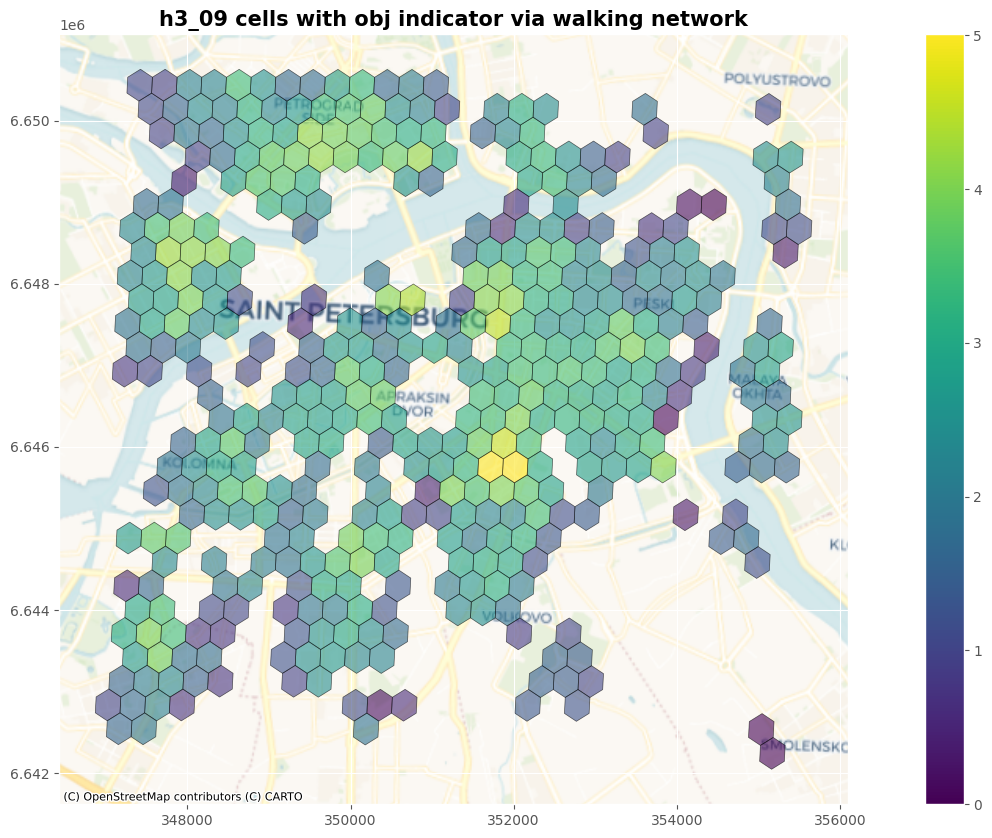

In [79]:
import contextily as cx
from matplotlib import pyplot as plt
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

with plt.style.context("ggplot"):
  ax = hex_09_with_obj_proj.plot(figsize=(20, 10), column='obj', legend=True, edgecolor='black', alpha=0.6)
  cx.add_basemap(ax=ax, crs=hex_09_with_obj_proj.crs.to_string(), source=cx.providers.CartoDB.Voyager)
  ax.set_title(f'{res_tag} cells with obj indicator via {network_type} network', fontsize=15, fontweight='bold')
  fp = config['dir_osm']+f'images/{res_tag}_cells_with_obj_via_{network_type}_network_'+start+'.png'
  plt.savefig(fp, bbox_inches='tight')
  logger.info(f'save {res_tag} cells with obj to {fp}')
  plt.show()

INFO:root:save h3_09 cells with obj to /content/drive/MyDrive/vkr/kmu/src/osm/images/h3_09_cells_with_obj_via_walking_network_with_pois_2024_05_06.png


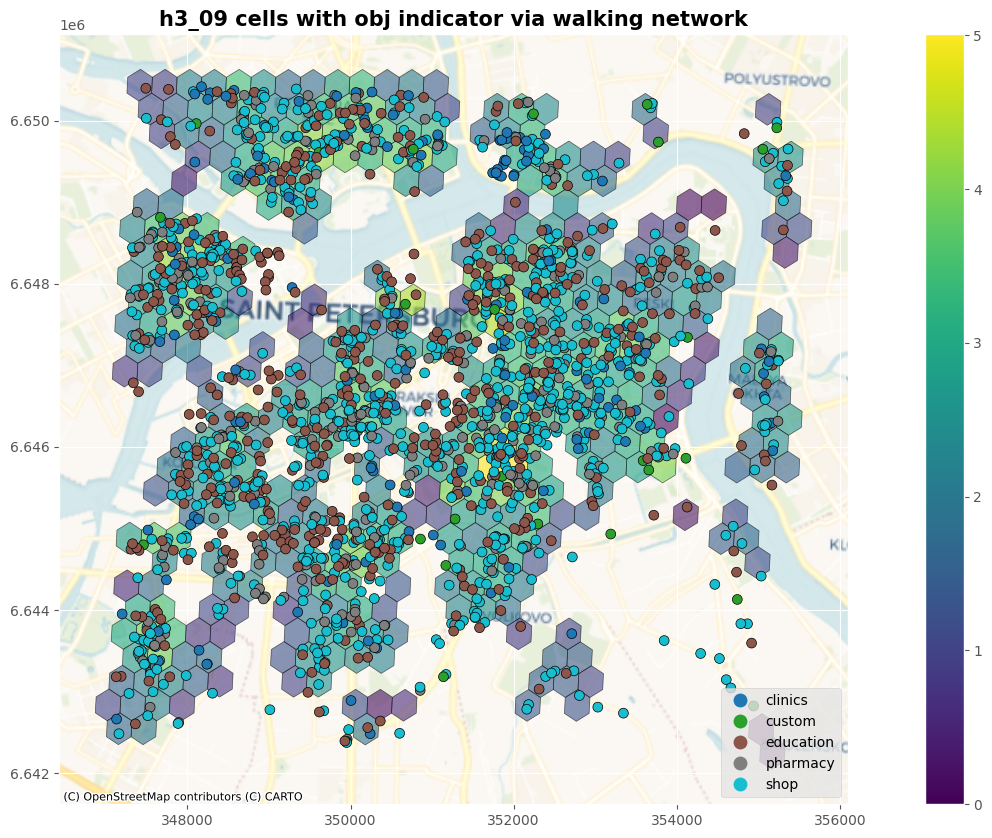

In [80]:
import contextily as cx
from matplotlib import pyplot as plt
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

with plt.style.context("ggplot"):
  ax = hex_09_with_obj_proj.plot(figsize=(20, 10), column='obj', legend=True, edgecolor='black', alpha=0.6)
  ax = pois.plot(ax=ax, column='pois_cat', legend=True, markersize=50, edgecolor='black')
  cx.add_basemap(ax=ax, crs=hex_09_with_obj_proj.crs.to_string(), source=cx.providers.CartoDB.Voyager)
  ax.set_title(f'{res_tag} cells with obj indicator via {network_type} network', fontsize=15, fontweight='bold')
  fp = config['dir_osm']+f'images/{res_tag}_cells_with_obj_via_{network_type}_network_with_pois_'+start+'.png'
  plt.savefig(fp, bbox_inches='tight')
  logger.info(f'save {res_tag} cells with obj to {fp}')
  plt.show()

INFO:root:save h3_09 cells with obj to /content/drive/MyDrive/vkr/kmu/src/osm/images/h3_09_cells_with_obj_via_walking_network_with_pois_zoom_2024_05_06.png


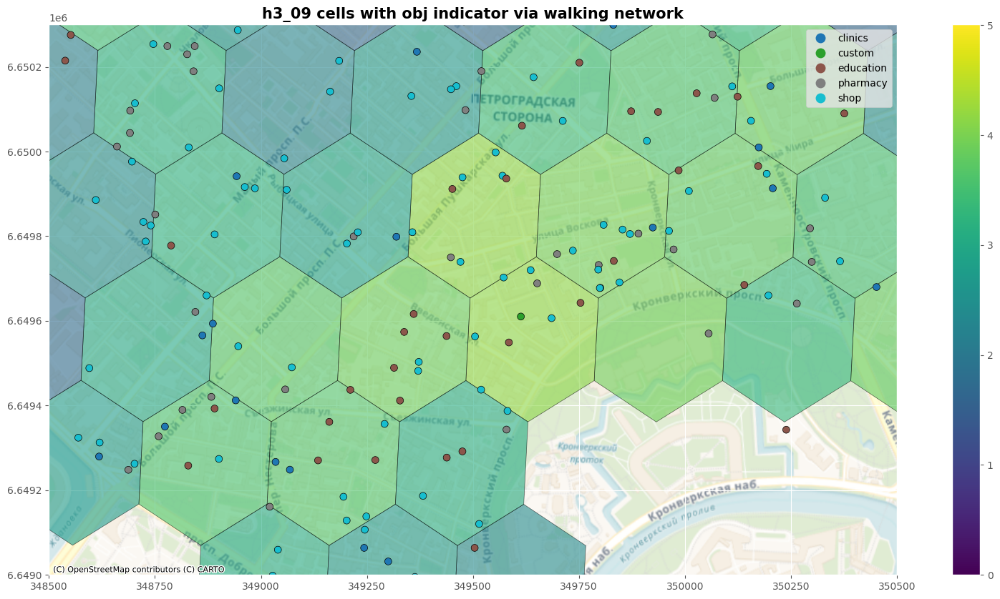

In [81]:
import contextily as cx
from matplotlib import pyplot as plt
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

with plt.style.context("ggplot"):
  ax = hex_09_with_obj_proj.plot(figsize=(20, 10), column='obj', legend=True, edgecolor='black', alpha=0.6)
  ax = pois.plot(ax=ax, column='pois_cat', legend=True, markersize=50, edgecolor='black')
  plt.setp(ax, xlim=(348500, 350500), ylim=(6649000, 6650300))
  cx.add_basemap(ax=ax, crs=hex_09_with_obj_proj.crs.to_string(), source=cx.providers.CartoDB.Voyager)
  ax.set_title(f'{res_tag} cells with obj indicator via {network_type} network', fontsize=15, fontweight='bold')
  fp = config['dir_osm']+f'images/{res_tag}_cells_with_obj_via_{network_type}_network_with_pois_zoom_'+start+'.png'
  plt.savefig(fp, bbox_inches='tight')
  logger.info(f'save {res_tag} cells with obj to {fp}')
  plt.show()

INFO:root:save h3_09 cells with obj to /content/drive/MyDrive/vkr/kmu/src/osm/images/h3_09_cells_with_obj_via_walking_network_with_pois_zoom_extra_2024_05_06.png


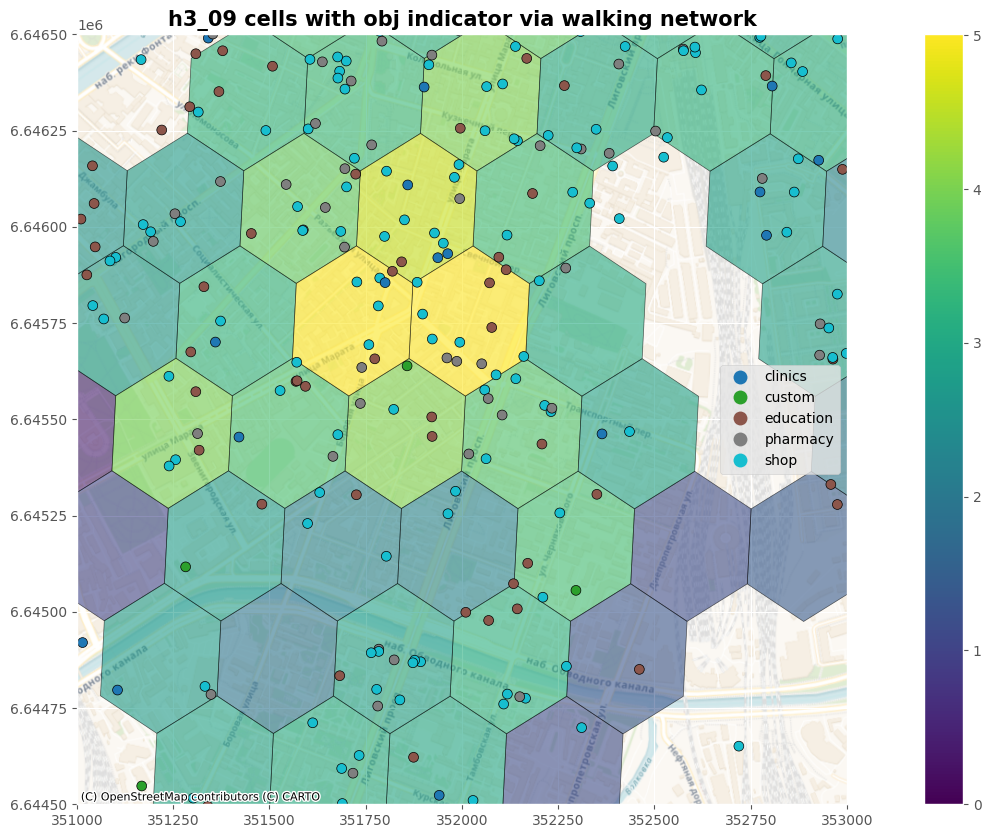

In [82]:
import contextily as cx
from matplotlib import pyplot as plt
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

with plt.style.context("ggplot"):
  ax = hex_09_with_obj_proj.plot(figsize=(20, 10), column='obj', legend=True, edgecolor='black', alpha=0.6)
  ax = pois.plot(ax=ax, column='pois_cat', legend=True, markersize=50, edgecolor='black')
  plt.setp(ax, xlim=(351000, 353000), ylim=(6644500, 6646500))
  cx.add_basemap(ax=ax, crs=hex_09_with_obj_proj.crs.to_string(), source=cx.providers.CartoDB.Voyager)
  ax.set_title(f'{res_tag} cells with obj indicator via {network_type} network', fontsize=15, fontweight='bold')
  fp = config['dir_osm']+f'images/{res_tag}_cells_with_obj_via_{network_type}_network_with_pois_zoom_extra_'+start+'.png'
  plt.savefig(fp, bbox_inches='tight')
  logger.info(f'save {res_tag} cells with obj to {fp}')
  plt.show()

/usr/local/lib/python3.10/dist-packages/geopandas/plotting.py:658: UserWarning: Only specify one of 'column' or 'color'. Using 'color'.
  warnings.warn(
INFO:root:save h3_09 cells with obj to /content/drive/MyDrive/vkr/kmu/src/osm/images/h3_09_cells_with_obj_via_walking_network_with_pois_and_buildings_zoom_extra_2024_05_06.png


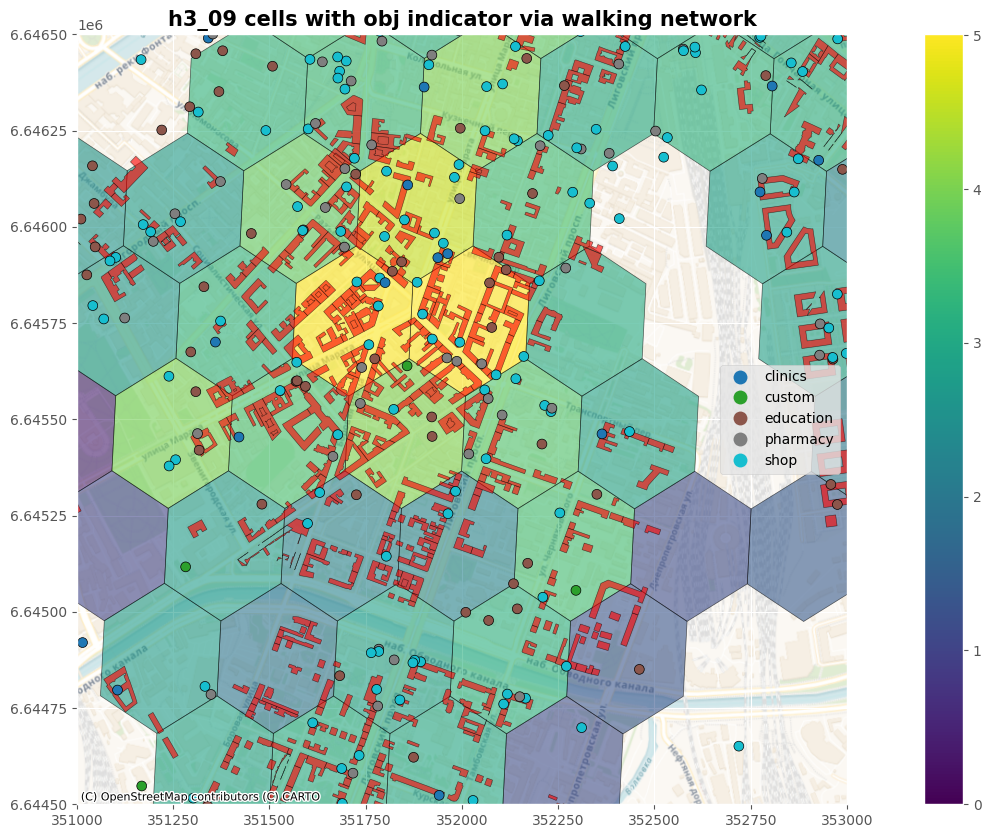

In [85]:
import contextily as cx
from matplotlib import pyplot as plt
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

with plt.style.context("ggplot"):
  ax = hex_09_with_obj_proj.plot(figsize=(20, 10), column='obj', legend=True, edgecolor='black', alpha=0.6)
  ax = buildings.plot(ax=ax, column='building', linewidth=0.4, color='red', edgecolor='black', alpha=0.6)
  ax = pois.plot(ax=ax, column='pois_cat', legend=True, markersize=50, edgecolor='black')
  plt.setp(ax, xlim=(351000, 353000), ylim=(6644500, 6646500))
  cx.add_basemap(ax=ax, crs=hex_09_with_obj_proj.crs.to_string(), source=cx.providers.CartoDB.Voyager)
  ax.set_title(f'{res_tag} cells with obj indicator via {network_type} network', fontsize=15, fontweight='bold')
  fp = config['dir_osm']+f'images/{res_tag}_cells_with_obj_via_{network_type}_network_with_pois_and_buildings_zoom_extra_'+start+'.png'
  plt.savefig(fp, bbox_inches='tight')
  logger.info(f'save {res_tag} cells with obj to {fp}')
  plt.show()

#### Сохранение

In [180]:
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

fp = ''
if 'bbox' in config:
  fp = config['dir_osm'] + 'spb_bbox_' + start + '.gpkg'
  hex_08_with_obj_proj.to_file(fp, driver='GPKG', layer='hex_08_with_obj_proj', encoding='utf-8')
  hex_09_with_obj_proj.to_file(fp, driver='GPKG', layer='hex_09_with_obj_proj', encoding='utf-8')
  logger.info(f'save hexs with obj indicator to {fp}')
else:
  fp = config['dir_osm'] + 'spb_' + start + '.gpkg'
  hex_08_with_obj_proj.to_file(fp, driver='GPKG', layer='hex_08_with_obj_proj', encoding='utf-8')
  hex_09_with_obj_proj.to_file(fp, driver='GPKG', layer='hex_09_with_obj_proj', encoding='utf-8')
  logger.info(f'save hexs with obj indicator to {fp}')

INFO:root:save hexs with obj indicator to /content/drive/MyDrive/vkr/kmu/src/osm/spb_bbox_2024_05_06.gpkg


[H3 resolution](https://russianblogs.com/article/93243931143/)

### Гексагоны с Subj
Subj = Risk (SOIKA)

In [ ]:
sys.path.append("/content/drive/MyDrive/vkr/kmu/SOIKA")
sys.path

['/content',
 '/env/python',
 '/usr/lib/python310.zip',
 '/usr/lib/python3.10',
 '/usr/lib/python3.10/lib-dynload',
 '',
 '/usr/local/lib/python3.10/dist-packages',
 '/usr/lib/python3/dist-packages',
 '/usr/local/lib/python3.10/dist-packages/IPython/extensions',
 '/root/.ipython',
 '/content/drive/MyDrive/vkr/kmu/virtual_env/lib/python3.10/site-packages',
 '/content/drive/MyDrive/vkr/kmu/SOIKA']

In [ ]:
sys.path.append("/content/SOIKA")
sys.path

['/content',
 '/env/python',
 '/usr/lib/python310.zip',
 '/usr/lib/python3.10',
 '/usr/lib/python3.10/lib-dynload',
 '',
 '/usr/local/lib/python3.10/dist-packages',
 '/usr/lib/python3/dist-packages',
 '/usr/local/lib/python3.10/dist-packages/IPython/extensions',
 '/root/.ipython',
 '/content/drive/MyDrive/vkr/kmu/virtual_env/lib/python3.10/site-packages',
 '/content/drive/MyDrive/vkr/kmu/SOIKA',
 '/content/SOIKA',
 '/content/SOIKA']

In [ ]:
!pip install bertopic==0.15.0

In [ ]:
!pip install flair==0.12.2

In [ ]:
import torch
import pandas as pd
from factfinder import EventDetection
import geopandas as gpd

target_texts = gpd.read_file('/content/SOIKA/data/processed/messages.geojson')
model = EventDetection()
messages, events, connections = model.run(target_texts, '/content/SOIKA/data/raw/population.geojson', 'Санкт-Петербург', 32636, min_event_size=3)

In [ ]:
fp = config['dir_osm'] + 'messages.gpkg'
messages.to_file(fp, driver='GPKG', layer='messages', encoding='utf-8')
logger.info(f'save messages to {fp}')
events.to_file(fp, driver='GPKG', layer='events', encoding='utf-8')
logger.info(f'save events to {fp}')
connections.to_file(fp, driver='GPKG', layer='connections', encoding='utf-8')
logger.info(f'save connections to {fp}')

INFO:root:save messages to /content/drive/MyDrive/vkr/kmu/src/osm/messages.gpkg
INFO:root:save events to /content/drive/MyDrive/vkr/kmu/src/osm/messages.gpkg
INFO:root:save connections to /content/drive/MyDrive/vkr/kmu/src/osm/messages.gpkg


In [87]:
fp = config['dir_osm'] + 'messages.gpkg'
messages_from_gpkg = read_file(fp, layer='messages')
events_from_gpkg = read_file(fp, layer='events')
connections_from_gpkg = read_file(fp, layer='connections')
logger.info(f'messages, events and connections successfully loaded from gpkg')

In [94]:
messages_from_gpkg.head(5)

,message_id,text,date_time,block,geometry
0,0,Здравствуйте! В Санкт-Петербурге нет Генеральн...,2023.01.26 16:32,Безопасность,POINT (30.30768 59.93180)
1,0,Здравствуйте! В Санкт-Петербурге нет Генеральн...,2023.01.26 16:32,Безопасность,POINT (30.30768 59.93180)
2,1,[club143265175|Центральный район Санкт-Петербу...,2023.01.26 11:55,ЖКХ,POINT (30.34628 59.93237)
3,2,"1) Фурштатская, 19 Отслоение штукатурного слоя...",2023.01.28 12:39,ЖКХ,POINT (30.35808 59.94512)
4,3,"2) Фурштатская, 17 Здесь прямо-таки умоляю обр...",2023.01.28 12:42,Благоустройство,POINT (30.35808 59.94512)


<Axes: xlabel='block'>

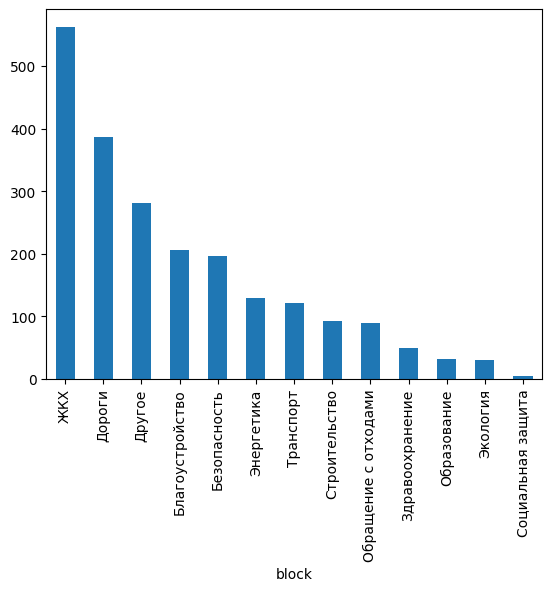

In [95]:
messages_from_gpkg.block.value_counts().plot(kind='bar')

In [92]:
messages_from_gpkg.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 2186 entries, 0 to 2185
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   message_id  2186 non-null   int64   
 1   text        2186 non-null   object  
 2   date_time   2186 non-null   object  
 3   block       2186 non-null   object  
 4   geometry    2186 non-null   geometry
dtypes: geometry(1), int64(1), object(3)
memory usage: 85.5+ KB


In [89]:
events_from_gpkg.head(5)

,name,docs,level,id,risk,message_ids,geometry
0,0_на_не_рубинштейна_по,"1, 1640, 1047",link,0_link_1273.0,0.046140,"18, 958, 173, 17, 1, 252, 1047, 1259, 1640, 154",POINT (30.34540 59.93201)
1,1_рубинштейна_ок рубинштейна_работает рубинште...,"425, 1238, 1239",link,1_link_1273.0,0.022886,"1238, 425, 1239",POINT (30.34520 59.93158)


In [93]:
events_from_gpkg.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 856 entries, 0 to 855
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype   
---  ------       --------------  -----   
 0   name         856 non-null    object  
 1   docs         856 non-null    object  
 2   level        856 non-null    object  
 3   id           856 non-null    object  
 4   risk         856 non-null    float64 
 5   message_ids  856 non-null    object  
 6   geometry     856 non-null    geometry
dtypes: float64(1), geometry(1), object(5)
memory usage: 46.9+ KB


In [97]:
events_from_gpkg[events_from_gpkg.risk == events_from_gpkg.risk.max()].values

array([['0_невский_невский проспект_проспект_не', '233, 147, 755',
        'link', '0_link_21557.0', 0.3642265426880811,
        '746, 361, 1058, 704, 1558, 832, 574, 1413, 1608, 1136, 871, 1428, 576, 1179, 1615, 24, 1633, 638, 1230, 1221, 1654, 176, 823, 596, 1410, 755, 91, 1589, 233, 1613, 1096, 1549, 736, 120, 246, 753, 1588, 77, 133, 86, 245, 1059, 597, 147, 281, 568, 735, 1433, 116, 1614, 1231, 1116',
        <POINT (30.352 59.932)>]], dtype=object)

In [98]:
connections_from_gpkg.head(5)

,weight,a,b,geometry
0,12,0_global_0,1_global_0,"LINESTRING (30.344 59.930, 30.368 59.928)"
1,12,0_global_0,2_global_0,"LINESTRING (30.344 59.930, 30.348 59.927)"
2,12,0_global_0,3_global_0,"LINESTRING (30.344 59.930, 30.349 59.932)"
3,12,0_global_0,4_global_0,"LINESTRING (30.344 59.930, 30.358 59.945)"
4,11,0_global_0,5_global_0,"LINESTRING (30.344 59.930, 30.366 59.940)"


In [100]:
events_from_gpkg.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [133]:
events_3d = events_from_gpkg

In [134]:
events_3d_norm = events_3d[['risk', 'geometry']]
events_3d_norm.risk = (events_3d_norm.risk - events_3d_norm.risk.min()) / (events_3d_norm.risk.max() - events_3d_norm.risk.min())
logger.info(f'linear normalization of risk')

/usr/local/lib/python3.10/dist-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
INFO:root:linear normalization of risk


In [135]:
M = 2 # amount of metrics in obj
K = 5 # amount of categories in obj

events_3d_norm['subj'] = M * K * events_3d_norm.risk
logger.info(f'add subj indicator to events')

/usr/local/lib/python3.10/dist-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
INFO:root:add subj indicator to events


In [136]:
events_3d_norm.head(2)

,risk,geometry,subj
0,0.120767,POINT (30.34540 59.93201),1.207666
1,0.056492,POINT (30.34520 59.93158),0.564918


#### h3_08

In [137]:
import h3pandas

res = 8
res_tag = 'h3_08'
hex_08_with_subj = events_3d_norm[['subj', 'geometry']].h3.geo_to_h3_aggregate(res, operation='mean').reset_index()
logger.info(f'aggregate subj indecator to {res_tag}')

INFO:root:aggregate subj indecator to h3_08


In [138]:
hex_08_with_subj.head(2)

,h3_08,subj,geometry
0,8811060601fffff,0.836143,"POLYGON ((30.34210 59.93469, 30.34743 59.93129..."
1,8811060603fffff,0.512468,"POLYGON ((30.35304 59.94015, 30.35837 59.93676..."


In [139]:
hex_08_with_subj.h3_08.value_counts()

h3_08
8811060601fffff    1
8811060603fffff    1
881106063bfffff    1
881106063dfffff    1
8811060641fffff    1
8811060643fffff    1
8811060645fffff    1
8811060647fffff    1
8811060649fffff    1
881106064dfffff    1
8811060655fffff    1
8811060663fffff    1
8811060667fffff    1
881106066bfffff    1
88110606c1fffff    1
8811061593fffff    1
881106a905fffff    1
8811060639fffff    1
8811060637fffff    1
8811060635fffff    1
8811060617fffff    1
8811060605fffff    1
8811060607fffff    1
8811060609fffff    1
881106060bfffff    1
881106060dfffff    1
8811060615fffff    1
881106061dfffff    1
8811060633fffff    1
8811060621fffff    1
8811060623fffff    1
8811060629fffff    1
881106062bfffff    1
881106062dfffff    1
8811060631fffff    1
881106a961fffff    1
Name: count, dtype: int64

In [140]:
hex_08_with_subj.shape

(36, 3)

In [141]:
hex_08_with_subj_proj = hex_08_with_subj.to_crs(config['crs'])

In [142]:
hex_08_with_subj_proj.head(2)

,h3_08,subj,geometry
0,8811060601fffff,0.836143,"POLYGON ((351482.873 6647119.638, 351765.735 6..."
1,8811060603fffff,0.512468,"POLYGON ((352118.093 6647703.694, 352400.985 6..."


INFO:root:save h3_08 cells with subj to /content/drive/MyDrive/vkr/kmu/src/osm/images/h3_08_cells_with_subj_via_walking_network_2024_05_06.png


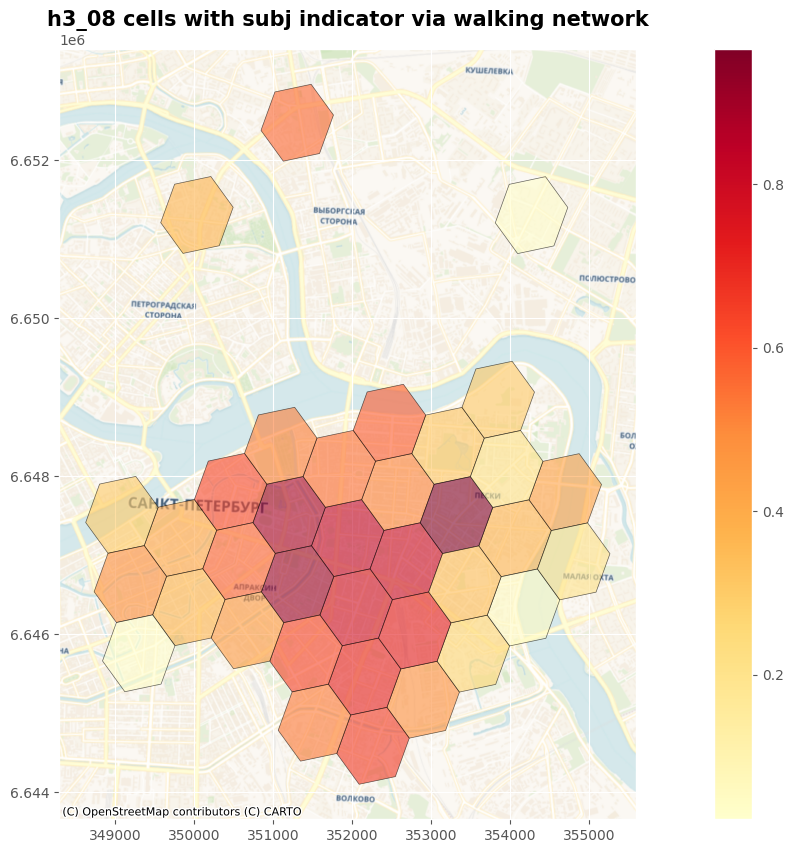

In [143]:
import contextily as cx
from matplotlib import pyplot as plt
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

with plt.style.context("ggplot"):
  ax = hex_08_with_subj_proj.plot(figsize=(20, 10), column='subj', legend=True, edgecolor='black', alpha=0.6, cmap='YlOrRd')
  cx.add_basemap(ax=ax, crs=hex_08_with_subj_proj.crs.to_string(), source=cx.providers.CartoDB.Voyager)
  ax.set_title(f'{res_tag} cells with subj indicator via {network_type} network', fontsize=15, fontweight='bold')
  fp = config['dir_osm']+f'images/{res_tag}_cells_with_subj_via_{network_type}_network_'+start+'.png'
  plt.savefig(fp, bbox_inches='tight')
  logger.info(f'save {res_tag} cells with subj to {fp}')
  plt.show()

In [144]:
messages_from_gpkg_proj = messages_from_gpkg.to_crs(config['crs'])

In [165]:
messages_from_gpkg_proj['x'] = messages_from_gpkg_proj.centroid.x
messages_from_gpkg_proj['y'] = messages_from_gpkg_proj.centroid.y

logger.info(f'add x, y to messages')

INFO:root:add x, y to messages


INFO:root:save h3_08 cells with subj to /content/drive/MyDrive/vkr/kmu/src/osm/images/h3_08_cells_with_subj_via_walking_network_with_block_2024_05_06.png


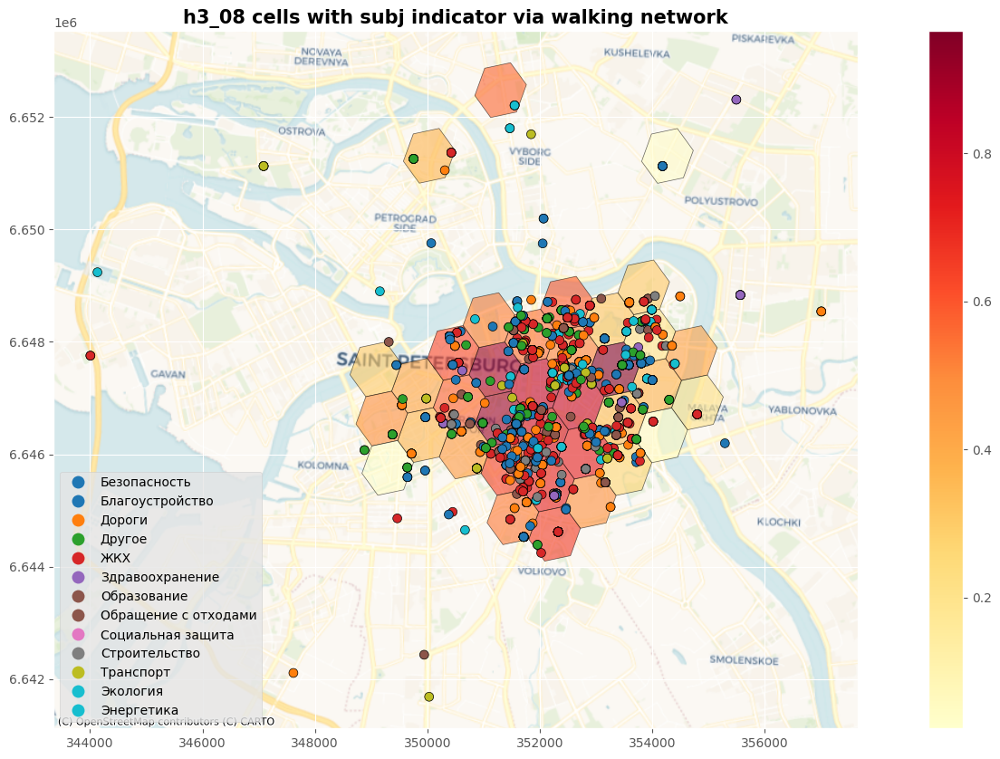

In [164]:
import contextily as cx
from matplotlib import pyplot as plt
from cycler import cycler
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

#palette = ['#ff0000', '#663600', '#a3cc00', '#80ffc3', '#0088ff', '#d9bfff', '#a6296c', '#8c4646', '#ff8800', '#5e664d', '#269991', '#1d3f73', '#7e468c']

with plt.style.context("ggplot"):
  ax = hex_08_with_subj_proj.plot(figsize=(20, 10), column='subj', legend=True, edgecolor='black', alpha=0.6, cmap='YlOrRd')
  #ax.set_prop_cycle(cycler('color', palette))
  ax = messages_from_gpkg_proj.plot(ax=ax, column='block', legend=True, markersize=50, edgecolor='black')
  cx.add_basemap(ax=ax, crs=hex_08_with_subj_proj.crs.to_string(), source=cx.providers.CartoDB.Voyager)
  ax.set_title(f'{res_tag} cells with subj indicator via {network_type} network', fontsize=15, fontweight='bold')
  fp = config['dir_osm']+f'images/{res_tag}_cells_with_subj_via_{network_type}_network_with_block_'+start+'.png'
  plt.savefig(fp, bbox_inches='tight')
  logger.info(f'save {res_tag} cells with subj to {fp}')
  plt.show()

INFO:root:save h3_08 cells with subj to /content/drive/MyDrive/vkr/kmu/src/osm/images/h3_08_cells_with_subj_via_walking_network_with_block_zoom_extra_2024_05_06.png


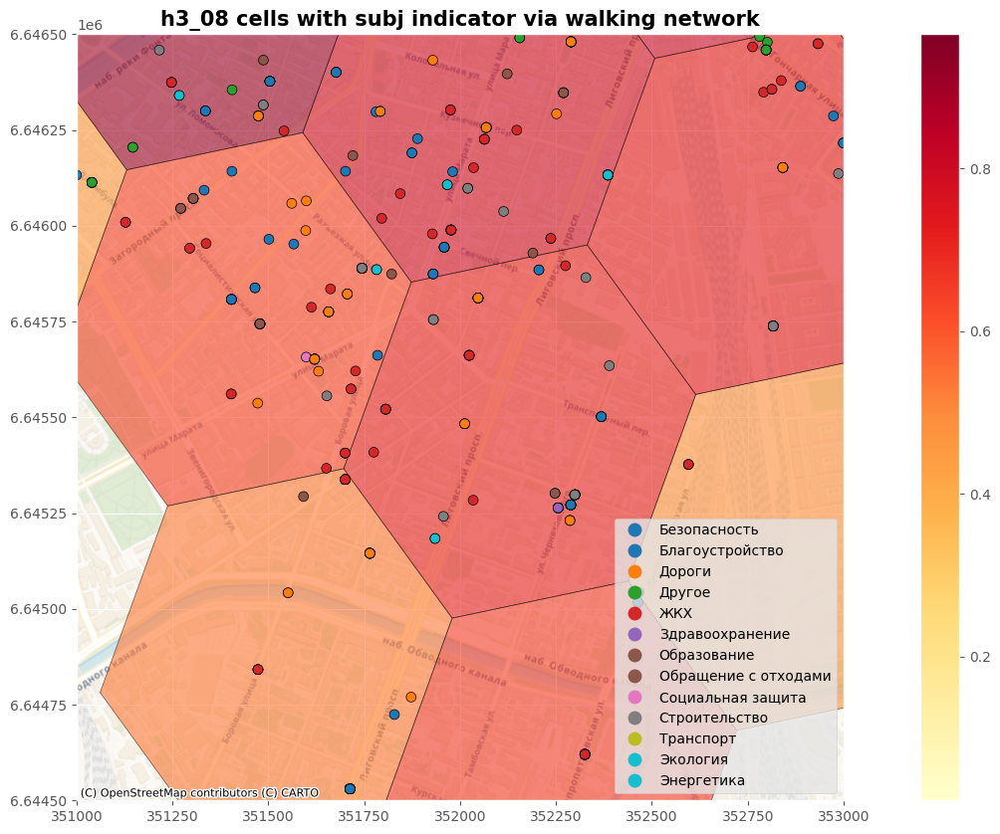

In [169]:
import contextily as cx
from matplotlib import pyplot as plt
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

with plt.style.context("ggplot"):
  ax = hex_08_with_subj_proj.plot(figsize=(20, 10), column='subj', legend=True, edgecolor='black', alpha=0.6, cmap='YlOrRd')
  ax = messages_from_gpkg_proj.plot(ax=ax, column='block', legend=True, markersize=50, edgecolor='black')
  plt.setp(ax, xlim=(351000, 353000), ylim=(6644500, 6646500))
  cx.add_basemap(ax=ax, crs=hex_08_with_subj_proj.crs.to_string(), source=cx.providers.CartoDB.Voyager)
  ax.set_title(f'{res_tag} cells with subj indicator via {network_type} network', fontsize=15, fontweight='bold')
  fp = config['dir_osm']+f'images/{res_tag}_cells_with_subj_via_{network_type}_network_with_block_zoom_extra_'+start+'.png'
  plt.savefig(fp, bbox_inches='tight')
  logger.info(f'save {res_tag} cells with subj to {fp}')
  plt.show()

#### h3_09

In [170]:
import h3pandas

res = 9
res_tag = 'h3_09'
hex_09_with_subj = events_3d_norm[['subj', 'geometry']].h3.geo_to_h3_aggregate(res, operation='mean').reset_index()
logger.info(f'aggregate subj indecator to {res_tag}')

INFO:root:aggregate subj indecator to h3_09


In [171]:
hex_09_with_subj.head(2)

,h3_09,subj,geometry
0,89110606007ffff,0.605681,"POLYGON ((30.35027 59.93747, 30.35296 59.93665..."
1,8911060600bffff,1.879944,"POLYGON ((30.35016 59.93222, 30.35285 59.93140..."


In [173]:
hex_09_with_subj.h3_09.value_counts()

h3_09
89110606007ffff    1
89110606383ffff    1
891106063c7ffff    1
891106063c3ffff    1
891106063bbffff    1
                  ..
891106060cfffff    1
891106060cbffff    1
891106060c7ffff    1
891106060bbffff    1
891106a9613ffff    1
Name: count, Length: 111, dtype: int64

In [174]:
hex_09_with_subj.shape

(111, 3)

In [175]:
hex_09_with_subj_proj = hex_09_with_subj.to_crs(config['crs'])

In [176]:
hex_09_with_subj_proj.head(2)

,h3_09,subj,geometry
0,89110606007ffff,0.605681,"POLYGON ((351951.839 6647411.540, 352098.242 6..."
1,8911060600bffff,1.879944,"POLYGON ((351922.062 6646826.991, 352068.466 6..."


INFO:root:save h3_09 cells with subj to /content/drive/MyDrive/vkr/kmu/src/osm/images/h3_09_cells_with_subj_via_walking_network_2024_05_06.png


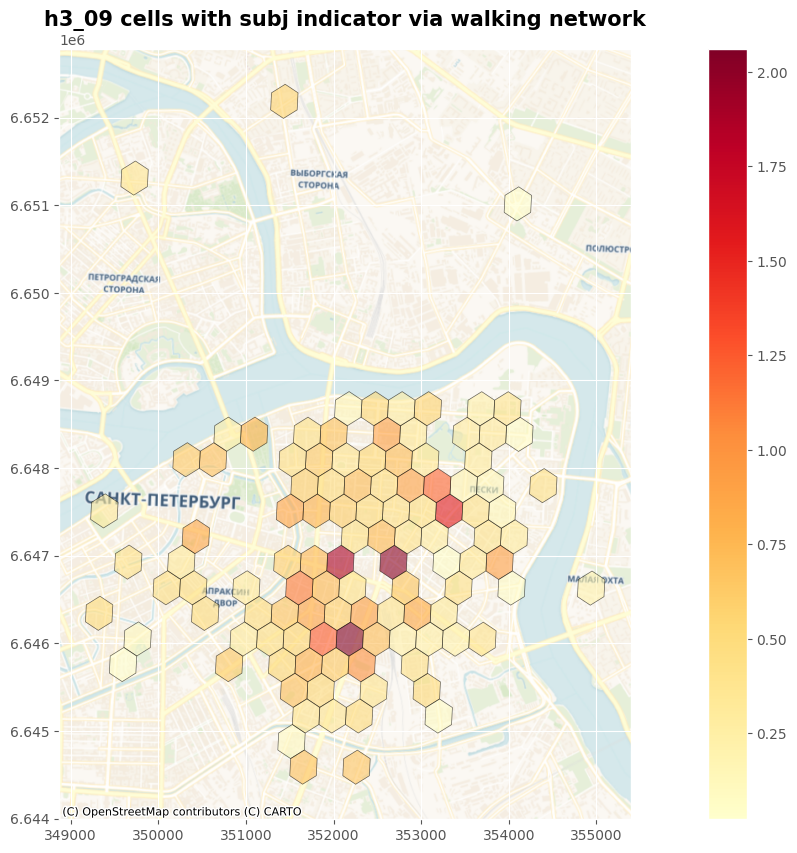

In [177]:
import contextily as cx
from matplotlib import pyplot as plt
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

with plt.style.context("ggplot"):
  ax = hex_09_with_subj_proj.plot(figsize=(20, 10), column='subj', legend=True, edgecolor='black', alpha=0.6, cmap='YlOrRd')
  cx.add_basemap(ax=ax, crs=hex_09_with_subj_proj.crs.to_string(), source=cx.providers.CartoDB.Voyager)
  ax.set_title(f'{res_tag} cells with subj indicator via {network_type} network', fontsize=15, fontweight='bold')
  fp = config['dir_osm']+f'images/{res_tag}_cells_with_subj_via_{network_type}_network_'+start+'.png'
  plt.savefig(fp, bbox_inches='tight')
  logger.info(f'save {res_tag} cells with subj to {fp}')
  plt.show()

INFO:root:save h3_09 cells with subj to /content/drive/MyDrive/vkr/kmu/src/osm/images/h3_09_cells_with_subj_via_walking_network_with_block_2024_05_06.png


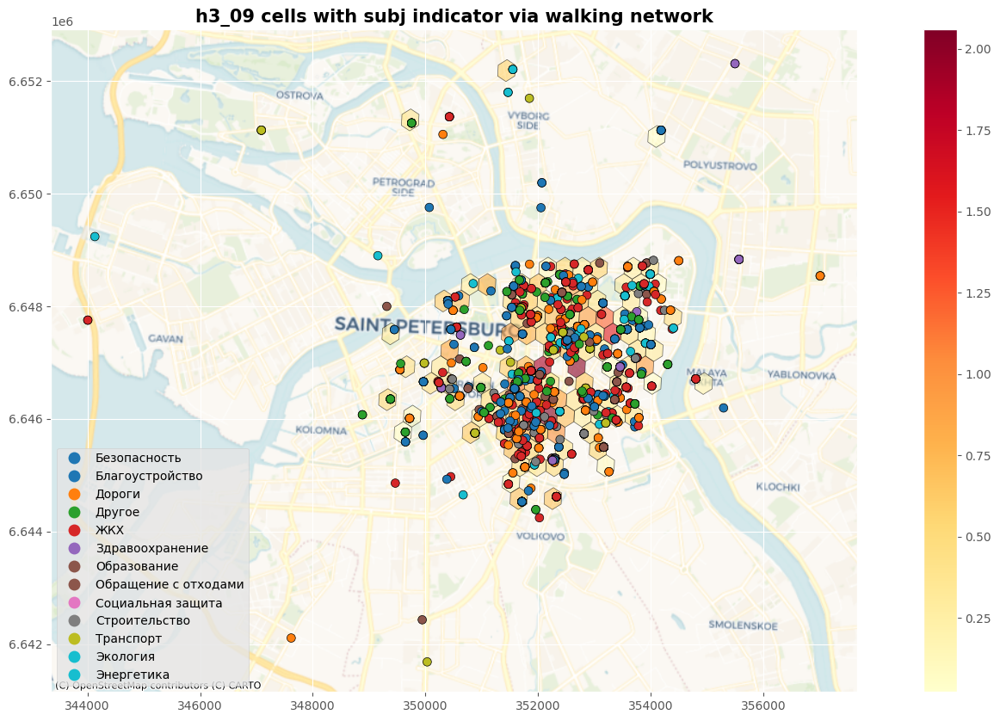

In [178]:
import contextily as cx
from matplotlib import pyplot as plt
from cycler import cycler
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

#palette = ['#ff0000', '#663600', '#a3cc00', '#80ffc3', '#0088ff', '#d9bfff', '#a6296c', '#8c4646', '#ff8800', '#5e664d', '#269991', '#1d3f73', '#7e468c']

with plt.style.context("ggplot"):
  ax = hex_09_with_subj_proj.plot(figsize=(20, 10), column='subj', legend=True, edgecolor='black', alpha=0.6, cmap='YlOrRd')
  #ax.set_prop_cycle(cycler('color', palette))
  ax = messages_from_gpkg_proj.plot(ax=ax, column='block', legend=True, markersize=50, edgecolor='black')
  cx.add_basemap(ax=ax, crs=hex_09_with_subj_proj.crs.to_string(), source=cx.providers.CartoDB.Voyager)
  ax.set_title(f'{res_tag} cells with subj indicator via {network_type} network', fontsize=15, fontweight='bold')
  fp = config['dir_osm']+f'images/{res_tag}_cells_with_subj_via_{network_type}_network_with_block_'+start+'.png'
  plt.savefig(fp, bbox_inches='tight')
  logger.info(f'save {res_tag} cells with subj to {fp}')
  plt.show()

INFO:root:save h3_09 cells with subj to /content/drive/MyDrive/vkr/kmu/src/osm/images/h3_09_cells_with_subj_via_walking_network_with_block_zoom_extra_2024_05_06.png


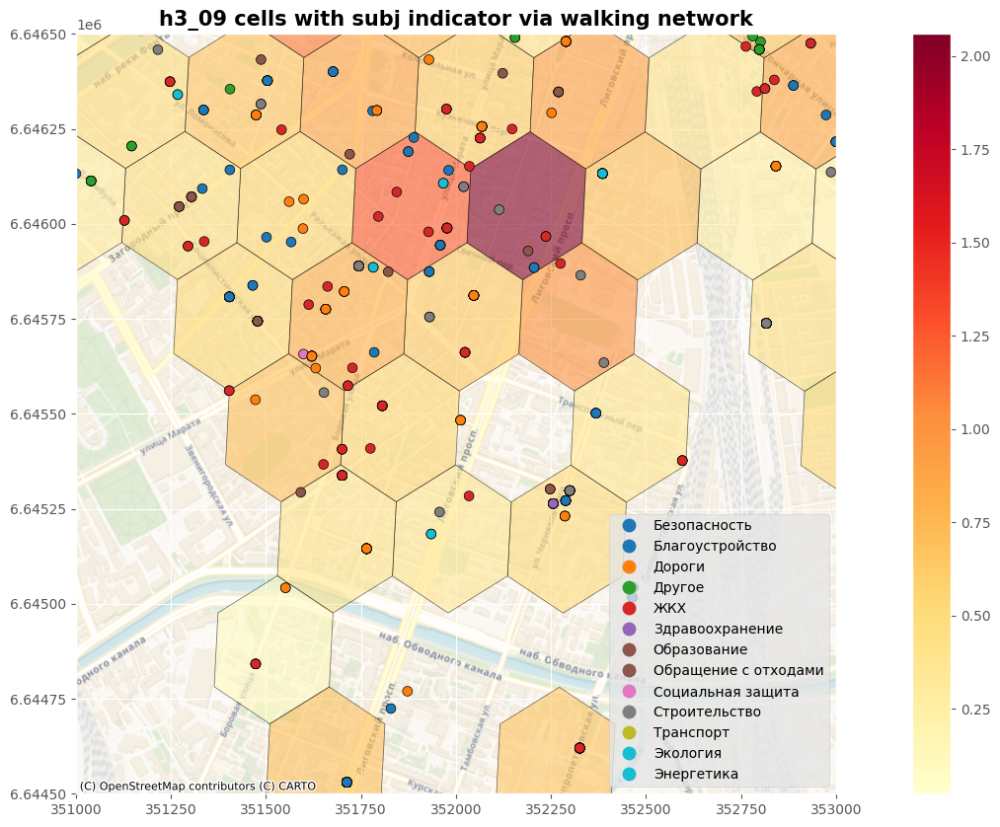

In [179]:
import contextily as cx
from matplotlib import pyplot as plt
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

with plt.style.context("ggplot"):
  ax = hex_09_with_subj_proj.plot(figsize=(20, 10), column='subj', legend=True, edgecolor='black', alpha=0.6, cmap='YlOrRd')
  ax = messages_from_gpkg_proj.plot(ax=ax, column='block', legend=True, markersize=50, edgecolor='black')
  plt.setp(ax, xlim=(351000, 353000), ylim=(6644500, 6646500))
  cx.add_basemap(ax=ax, crs=hex_09_with_subj_proj.crs.to_string(), source=cx.providers.CartoDB.Voyager)
  ax.set_title(f'{res_tag} cells with subj indicator via {network_type} network', fontsize=15, fontweight='bold')
  fp = config['dir_osm']+f'images/{res_tag}_cells_with_subj_via_{network_type}_network_with_block_zoom_extra_'+start+'.png'
  plt.savefig(fp, bbox_inches='tight')
  logger.info(f'save {res_tag} cells with subj to {fp}')
  plt.show()

#### Сохранение

In [182]:
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

fp = ''
if 'bbox' in config:
  fp = config['dir_osm'] + 'spb_bbox_' + start + '.gpkg'
  hex_08_with_subj_proj.to_file(fp, driver='GPKG', layer='hex_08_with_subj_proj', encoding='utf-8')
  hex_09_with_subj_proj.to_file(fp, driver='GPKG', layer='hex_09_with_subj_proj', encoding='utf-8')
  logger.info(f'save hexs with obj indicator to {fp}')
else:
  fp = config['dir_osm'] + 'spb_' + start + '.gpkg'
  hex_08_with_subj_proj.to_file(fp, driver='GPKG', layer='hex_08_with_subj_proj', encoding='utf-8')
  hex_09_with_subj_proj.to_file(fp, driver='GPKG', layer='hex_09_with_subj_proj', encoding='utf-8')
  logger.info(f'save hexs with subj indicator to {fp}')

INFO:root:save hexs with obj indicator to /content/drive/MyDrive/vkr/kmu/src/osm/spb_bbox_2024_05_06.gpkg


### Гексагоны с UQI

#### h3_08

In [187]:
res = 8
res_tag = 'h3_08'
hex_08_with_uqi = hex_08_with_obj_proj.merge(hex_08_with_subj_proj.drop(columns='geometry'), left_on='h3_08', right_on='h3_08')
logger.info(f'aggregate subj indecator to {res_tag}')

INFO:root:aggregate subj indecator to h3_08


In [188]:
hex_08_with_uqi.head(2)

,h3_08,obj,geometry,subj
0,8811060601fffff,3.415007,"POLYGON ((351482.873 6647119.638, 351765.735 6...",0.836143
1,8811060603fffff,2.905702,"POLYGON ((352118.093 6647703.694, 352400.985 6...",0.512468


In [189]:
hex_08_with_uqi.shape

(33, 4)

In [190]:
hex_08_with_uqi['uqi'] = hex_08_with_uqi.obj - hex_08_with_uqi.subj

In [191]:
hex_08_with_uqi.head(2)

,h3_08,obj,geometry,subj,uqi
0,8811060601fffff,3.415007,"POLYGON ((351482.873 6647119.638, 351765.735 6...",0.836143,2.578864
1,8811060603fffff,2.905702,"POLYGON ((352118.093 6647703.694, 352400.985 6...",0.512468,2.393234


INFO:root:save h3_08 cells with uqi to /content/drive/MyDrive/vkr/kmu/src/osm/images/h3_08_cells_with_uqi_via_walking_network_2024_05_06.png


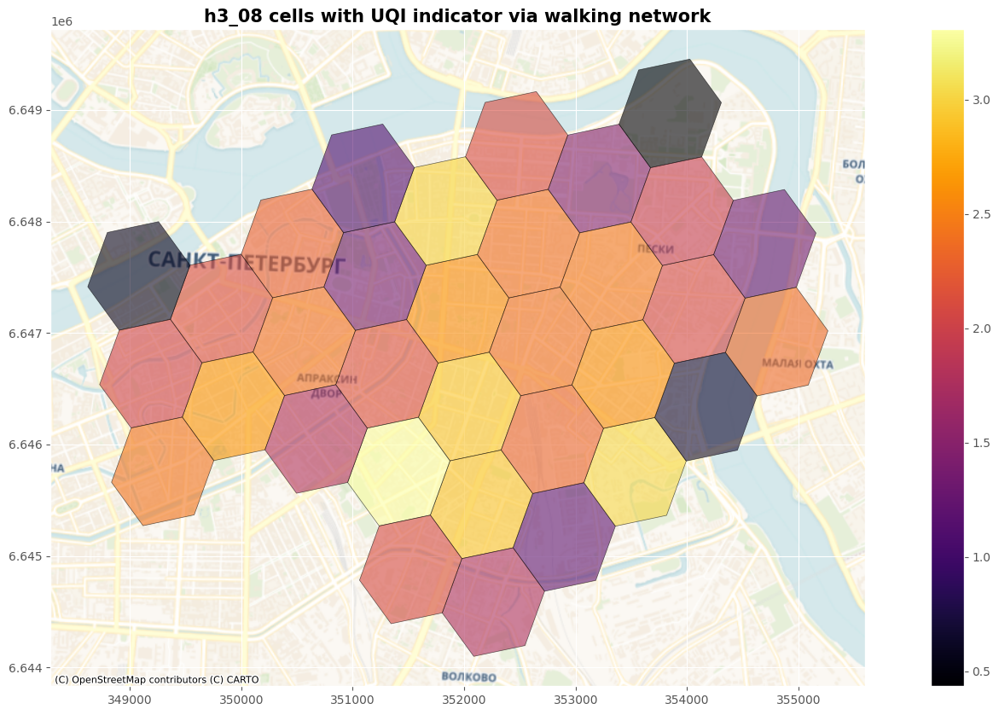

In [195]:
import contextily as cx
from matplotlib import pyplot as plt
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

with plt.style.context("ggplot"):
  ax = hex_08_with_uqi.plot(figsize=(20, 10), column='uqi', legend=True, edgecolor='black', alpha=0.6, cmap='inferno')
  cx.add_basemap(ax=ax, crs=hex_08_with_uqi.crs.to_string(), source=cx.providers.CartoDB.Voyager)
  ax.set_title(f'{res_tag} cells with UQI indicator via {network_type} network', fontsize=15, fontweight='bold')
  fp = config['dir_osm']+f'images/{res_tag}_cells_with_uqi_via_{network_type}_network_'+start+'.png'
  plt.savefig(fp, bbox_inches='tight')
  logger.info(f'save {res_tag} cells with uqi to {fp}')
  plt.show()

INFO:root:save h3_08 cells with uqi to /content/drive/MyDrive/vkr/kmu/src/osm/images/h3_08_cells_with_uqi_via_walking_network_zoom_extra_2024_05_06.png


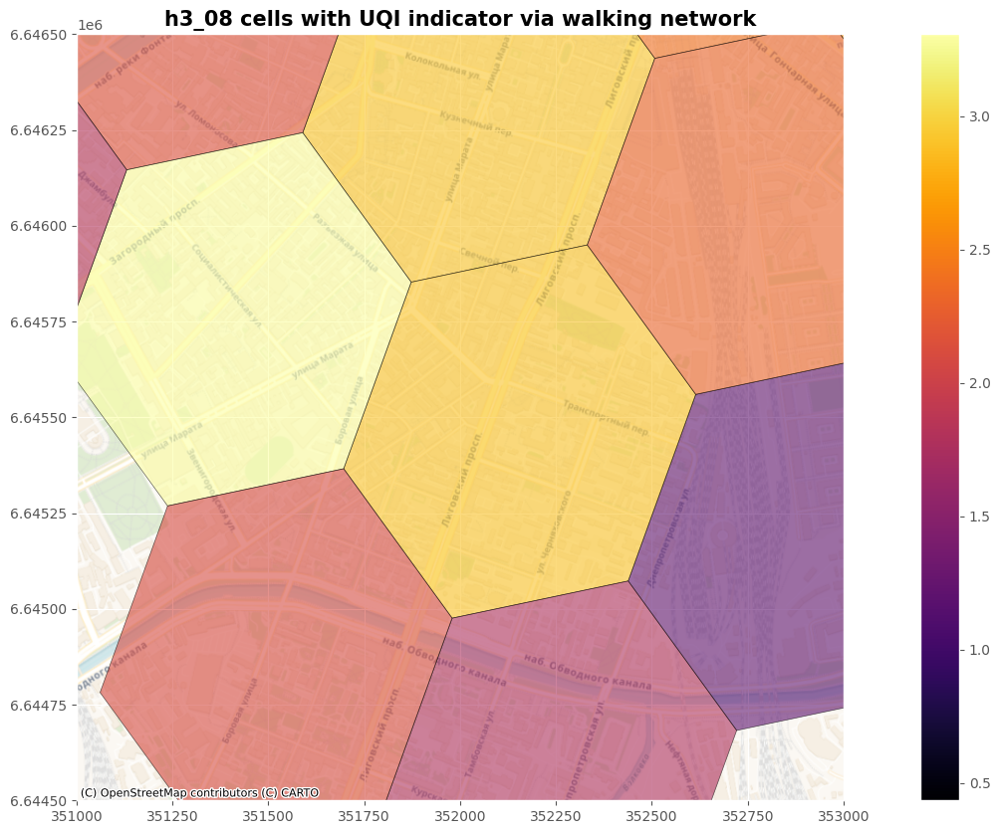

In [196]:
import contextily as cx
from matplotlib import pyplot as plt
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

with plt.style.context("ggplot"):
  ax = hex_08_with_uqi.plot(figsize=(20, 10), column='uqi', legend=True, edgecolor='black', alpha=0.6, cmap='inferno')
  #ax = messages_from_gpkg_proj.plot(ax=ax, column='block', legend=True, markersize=50, edgecolor='black')
  plt.setp(ax, xlim=(351000, 353000), ylim=(6644500, 6646500))
  cx.add_basemap(ax=ax, crs=hex_08_with_uqi.crs.to_string(), source=cx.providers.CartoDB.Voyager)
  ax.set_title(f'{res_tag} cells with UQI indicator via {network_type} network', fontsize=15, fontweight='bold')
  fp = config['dir_osm']+f'images/{res_tag}_cells_with_uqi_via_{network_type}_network_zoom_extra_'+start+'.png'
  plt.savefig(fp, bbox_inches='tight')
  logger.info(f'save {res_tag} cells with uqi to {fp}')
  plt.show()

INFO:root:save h3_08 cells with uqi to /content/drive/MyDrive/vkr/kmu/src/osm/images/h3_08_cells_with_uqi_via_walking_network_with_pois_and_blocks_zoom_extra_2024_05_06.png


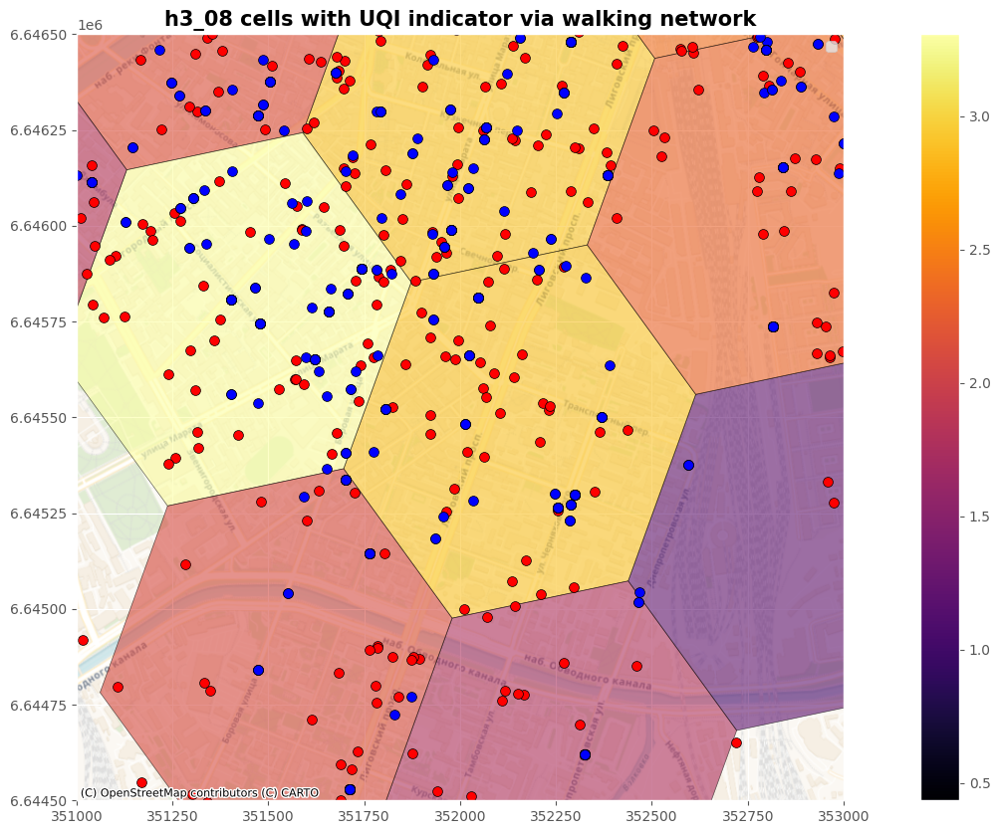

In [209]:
import contextily as cx
from matplotlib import pyplot as plt
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

with plt.style.context("ggplot"):
  ax = hex_08_with_uqi.plot(figsize=(20, 10), column='uqi', legend=True, edgecolor='black', alpha=0.6, cmap='inferno')
  ax = pois.plot(ax=ax, legend=True, markersize=50, color='red', edgecolor='black')
  ax = messages_from_gpkg_proj.plot(ax=ax, legend=True, markersize=50, color='blue', edgecolor='black')
  plt.setp(ax, xlim=(351000, 353000), ylim=(6644500, 6646500))

  plt.legend()
  cx.add_basemap(ax=ax, crs=hex_08_with_uqi.crs.to_string(), source=cx.providers.CartoDB.Voyager)
  ax.set_title(f'{res_tag} cells with UQI indicator via {network_type} network', fontsize=15, fontweight='bold')
  fp = config['dir_osm']+f'images/{res_tag}_cells_with_uqi_via_{network_type}_network_with_pois_and_blocks_zoom_extra_'+start+'.png'
  plt.savefig(fp, bbox_inches='tight')
  logger.info(f'save {res_tag} cells with uqi to {fp}')
  plt.show()

#### h3_09

In [210]:
res = 9
res_tag = 'h3_09'
hex_09_with_uqi = hex_09_with_obj_proj.merge(hex_09_with_subj_proj.drop(columns='geometry'), left_on='h3_09', right_on='h3_09')
logger.info(f'aggregate subj indecator to {res_tag}')

INFO:root:aggregate subj indecator to h3_09


In [211]:
hex_09_with_uqi.head(2)

,h3_09,obj,geometry,subj
0,89110606007ffff,3.279900,"POLYGON ((351951.839 6647411.540, 352098.242 6...",0.605681
1,8911060600bffff,3.454379,"POLYGON ((351922.062 6646826.991, 352068.466 6...",1.879944


In [212]:
hex_09_with_uqi.shape

(100, 4)

In [213]:
hex_09_with_uqi['uqi'] = hex_09_with_uqi.obj - hex_09_with_uqi.subj

In [214]:
hex_09_with_uqi.head(2)

,h3_09,obj,geometry,subj,uqi
0,89110606007ffff,3.279900,"POLYGON ((351951.839 6647411.540, 352098.242 6...",0.605681,2.674219
1,8911060600bffff,3.454379,"POLYGON ((351922.062 6646826.991, 352068.466 6...",1.879944,1.574435


INFO:root:save h3_09 cells with uqi to /content/drive/MyDrive/vkr/kmu/src/osm/images/h3_09_cells_with_uqi_via_walking_network_2024_05_06.png


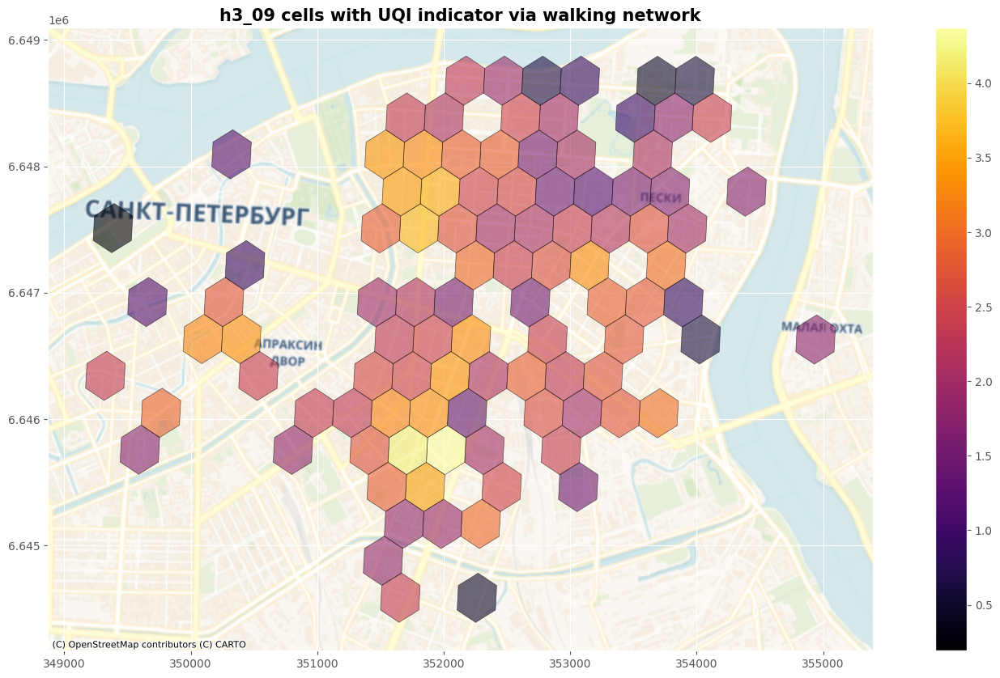

In [215]:
import contextily as cx
from matplotlib import pyplot as plt
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

with plt.style.context("ggplot"):
  ax = hex_09_with_uqi.plot(figsize=(20, 10), column='uqi', legend=True, edgecolor='black', alpha=0.6, cmap='inferno')
  cx.add_basemap(ax=ax, crs=hex_09_with_uqi.crs.to_string(), source=cx.providers.CartoDB.Voyager)
  ax.set_title(f'{res_tag} cells with UQI indicator via {network_type} network', fontsize=15, fontweight='bold')
  fp = config['dir_osm']+f'images/{res_tag}_cells_with_uqi_via_{network_type}_network_'+start+'.png'
  plt.savefig(fp, bbox_inches='tight')
  logger.info(f'save {res_tag} cells with uqi to {fp}')
  plt.show()

INFO:root:save h3_09 cells with uqi to /content/drive/MyDrive/vkr/kmu/src/osm/images/h3_09_cells_with_uqi_via_walking_network_zoom_extra_2024_05_06.png


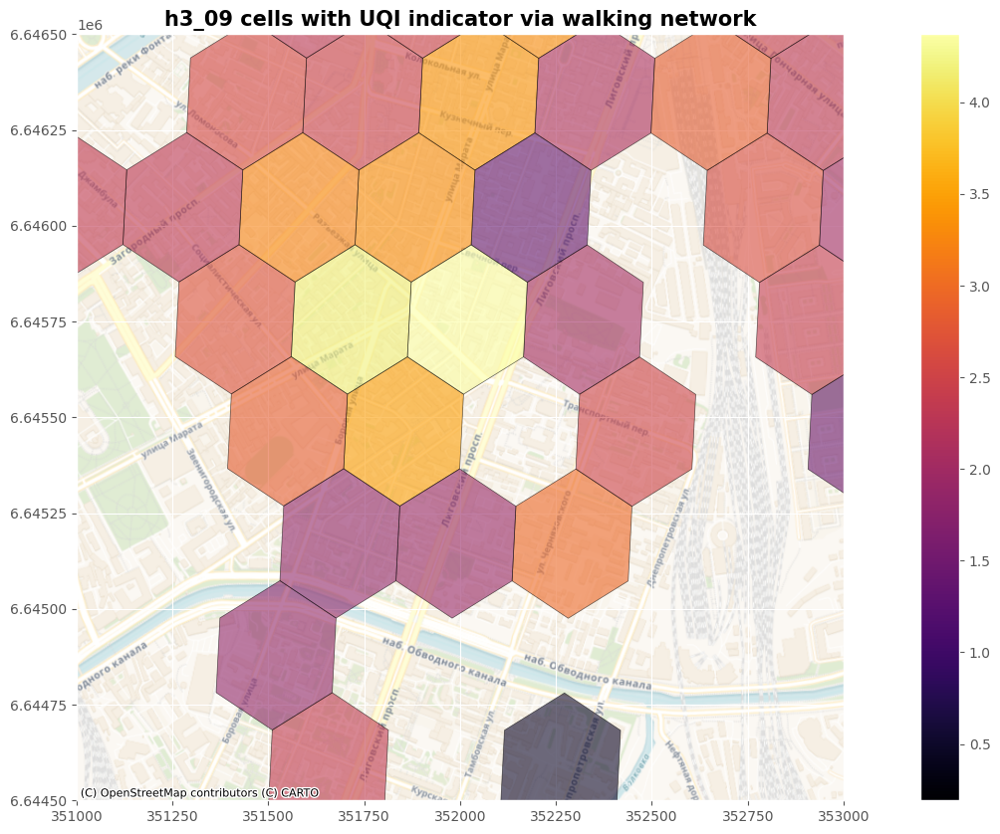

In [216]:
import contextily as cx
from matplotlib import pyplot as plt
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

with plt.style.context("ggplot"):
  ax = hex_09_with_uqi.plot(figsize=(20, 10), column='uqi', legend=True, edgecolor='black', alpha=0.6, cmap='inferno')
  #ax = messages_from_gpkg_proj.plot(ax=ax, column='block', legend=True, markersize=50, edgecolor='black')
  plt.setp(ax, xlim=(351000, 353000), ylim=(6644500, 6646500))
  cx.add_basemap(ax=ax, crs=hex_09_with_uqi.crs.to_string(), source=cx.providers.CartoDB.Voyager)
  ax.set_title(f'{res_tag} cells with UQI indicator via {network_type} network', fontsize=15, fontweight='bold')
  fp = config['dir_osm']+f'images/{res_tag}_cells_with_uqi_via_{network_type}_network_zoom_extra_'+start+'.png'
  plt.savefig(fp, bbox_inches='tight')
  logger.info(f'save {res_tag} cells with uqi to {fp}')
  plt.show()

#### Сохранение

In [217]:
import datetime

start = datetime.datetime.today().strftime("%Y_%m_%d")

fp = ''
if 'bbox' in config:
  fp = config['dir_osm'] + 'spb_bbox_' + start + '.gpkg'
  hex_08_with_uqi.to_file(fp, driver='GPKG', layer='hex_08_with_uqi', encoding='utf-8')
  hex_09_with_uqi.to_file(fp, driver='GPKG', layer='hex_09_with_uqi', encoding='utf-8')
  logger.info(f'save hexs with obj indicator to {fp}')
else:
  fp = config['dir_osm'] + 'spb_' + start + '.gpkg'
  hex_08_with_uqi.to_file(fp, driver='GPKG', layer='hex_08_with_uqi', encoding='utf-8')
  hex_09_with_uqi.to_file(fp, driver='GPKG', layer='hex_09_with_uqi', encoding='utf-8')
  logger.info(f'save hexs with uqi indicator to {fp}')

INFO:root:save hexs with obj indicator to /content/drive/MyDrive/vkr/kmu/src/osm/spb_bbox_2024_05_06.gpkg
